# Annotation pipeline

We here provide the pipeline to load the various segmentation schemes to AnnData and perform cell-typing. We show the code to perform annotation transfer between the different segmentation schemes.

In [ ]:
import pandas as pd
import numpy as np
import anndata as ad
import scanpy as sc
from scvi.external import RESOLVI
import matplotlib.pyplot as plt

2024-07-18 01:25:51.462930: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Load input data

### Baysor

In [5]:
import glob
files = glob.glob('baysor_transcripts/segmentation_fov_*[0-9].csv')
files_dict = {int(file[file.find('fov_')+4:file.find('fov_')+6].strip('.')):file for file in files}

In [ ]:
adata = {}

for key, value in files_dict.items():
    print(key)
    df = pd.read_csv(value)
    df["v"] = np.ones(df.shape[0], int)
    df=df[df['is_noise']==False]
    adata[key] = sc.AnnData(df[['cell', 'gene', 'v']].groupby(['cell', 'gene']).sum().pivot_table('v', index='cell', columns='gene').fillna(0).iloc[1:])
    df = pd.read_csv('baysor_transcripts/segmentation_fov_' + str(key) + '_cell_stats.csv', index_col='cell')
    indices = np.intersect1d(df.index, adata[key].obs_names.astype(int))
    print(adata[key])
    adata[key] = adata[key][indices.astype(str)]
    print(adata[key])
    adata[key].obs = pd.read_csv('baysor_transcripts/segmentation_fov_' + str(key) + '_cell_stats.csv', index_col='cell').loc[indices]
baysor = ad.concat(list(adata.values()), label='fov', keys=list(adata.keys()), join='outer', fill_value=0)


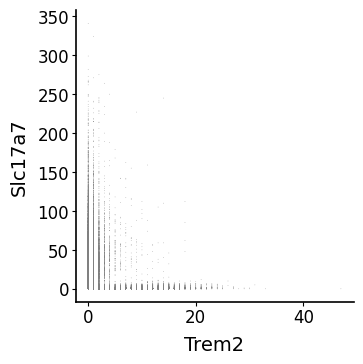

In [9]:
sc.pl.scatter(baysor, x='Trem2', y='Slc17a7')

In [10]:
baysor.obsm['X_spatial'] = baysor.obs[['x', 'y']].values
baysor.obs['fov_original'] = baysor.obs['fov']

In [11]:
baysor.write_h5ad('xenium_brain_baysor.h5ad')

### Xenium original segmentation

In [6]:
pd.read_csv('cells.csv.gz')

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,cell_area,nucleus_area
0,1,1272.833496,3368.138281,217,0,0,217,310.087969,33.731719
1,2,1644.378748,3278.816272,429,0,0,430,400.852031,55.677656
2,3,1656.137323,3086.458533,339,0,0,342,433.951563,49.310625
3,4,1674.793951,2865.257446,206,0,0,207,259.693594,39.015000
4,5,1673.007208,2930.809546,498,1,0,500,690.348750,41.092188
...,...,...,...,...,...,...,...,...,...
130865,130866,8323.272217,4967.370117,361,0,0,361,874.631406,39.782656
130866,130867,8323.074658,4994.026001,484,0,0,484,715.004063,68.818125
130867,130868,8320.107129,4934.747632,445,0,0,446,653.456094,13.456563
130868,130869,8316.603369,4905.530542,736,0,0,736,570.187969,68.818125


In [7]:
adata = sc.read_10x_h5('cell_feature_matrix.h5')
obs = pd.read_csv('cells.csv.gz', index_col='cell_id')
obs.index = obs.index.astype(str)
adata.obs = obs

In [8]:
adata.var

,gene_ids,feature_types,genome
2010300C02Rik,ENSMUSG00000026090,Gene Expression,Unknown
Acsbg1,ENSMUSG00000032281,Gene Expression,Unknown
Acta2,ENSMUSG00000035783,Gene Expression,Unknown
Acvrl1,ENSMUSG00000000530,Gene Expression,Unknown
Adamts2,ENSMUSG00000036545,Gene Expression,Unknown
...,...,...,...
Vwc2l,ENSMUSG00000045648,Gene Expression,Unknown
Wfs1,ENSMUSG00000039474,Gene Expression,Unknown
Zfp366,ENSMUSG00000050919,Gene Expression,Unknown
Zfp536,ENSMUSG00000043456,Gene Expression,Unknown


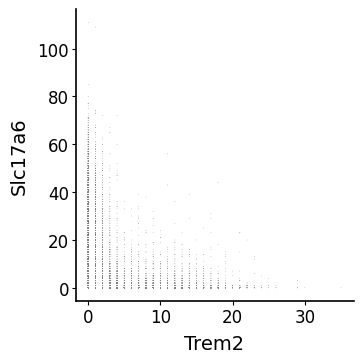

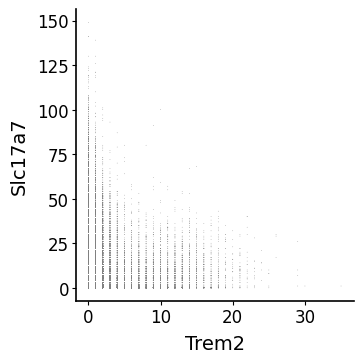

In [9]:
sc.pl.scatter(adata, x='Trem2', y='Slc17a6')
sc.pl.scatter(adata, x='Trem2', y='Slc17a7')

In [10]:
adata.layers['raw_counts'] = adata.X.copy()

In [11]:
adata.obsm['X_spatial'] = adata.obs[['x_centroid', 'y_centroid']].values

In [12]:
adata.write_h5ad('xenium_brain_original.h5ad')

### Proseg

In [ ]:
proseg = anndata.AnnData(X=pd.read_csv('expected-counts.csv.gz'))

In [10]:
cell_meta = pd.read_csv('transcript-metadata.csv.gz')
cell_meta = cell_meta # [cell_meta['background']==0]
cell_avg = cell_meta.groupby('assignment').mean()
cell_avg = cell_avg.loc[proseg.obs.index.astype(int).intersection(cell_avg.index)]
cell_avg.index = [str(i) for i in cell_avg.index]
proseg = proseg[cell_avg.index]
proseg.obs = cell_avg

/tmp/ipykernel_1917592/109400481.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  cell_avg = cell_meta.groupby('assignment').mean()


In [11]:
cell_meta['v'] = np.ones(cell_meta.shape[0], int)
counts = cell_meta[['assignment', 'gene', 'v']].groupby(['assignment', 'gene']).sum().pivot_table('v', index='assignment', columns='gene').fillna(0)
proseg.layers['counts'] = counts.loc[proseg.obs_names.astype(int), proseg.var_names]

In [15]:
counts_sub = cell_meta.loc[cell_meta['background']==0, ['assignment', 'gene', 'v']].groupby(['assignment', 'gene']).sum().pivot_table('v', index='assignment', columns='gene').fillna(0)
new_indices = [16873, 63868, 102578, 121788, 123933, 124023, 126753, 128327, 129848, 129987]

# Create a new DataFrame with all zeros and the specified indices
new_rows = pd.DataFrame(0, index=new_indices, columns=counts_sub.columns)

# Append the new rows to the original DataFrame
counts_sub = counts_sub.append(new_rows)

/tmp/ipykernel_1917592/591046937.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  counts_sub = counts_sub.append(new_rows)


In [16]:
proseg.layers['counts_wo_bg'] = counts_sub.loc[proseg.obs_names.astype(int), proseg.var_names]

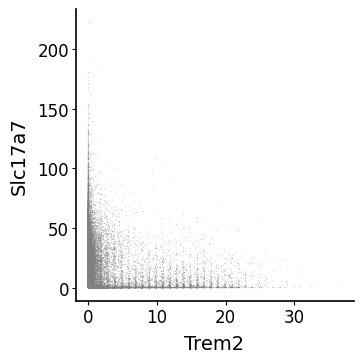

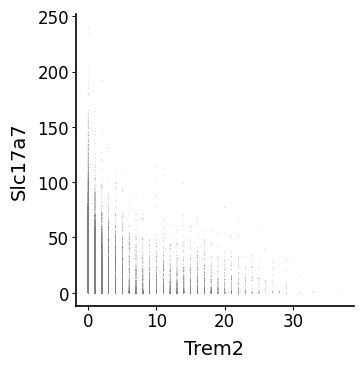

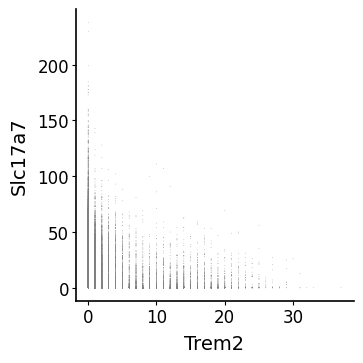

In [17]:
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7')
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7', layers='counts')
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7', layers='counts_wo_bg')

In [19]:
proseg

AnnData object with n_obs × n_vars = 130494 × 541
    obs: 'transcript_id', 'x', 'y', 'z', 'observed_x', 'observed_y', 'observed_z', 'fov', 'probability', 'background', 'confusion'
    layers: 'counts', 'counts_wo_bg'

In [18]:
proseg.write_h5ad('xenium_brain_proseg.h5ad')

In [ ]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
_utils.compute_umap_embedding(adata, representation_key="raw_counts", show=True, key='raw_counts', n_neighbors=30, extra_save='original')

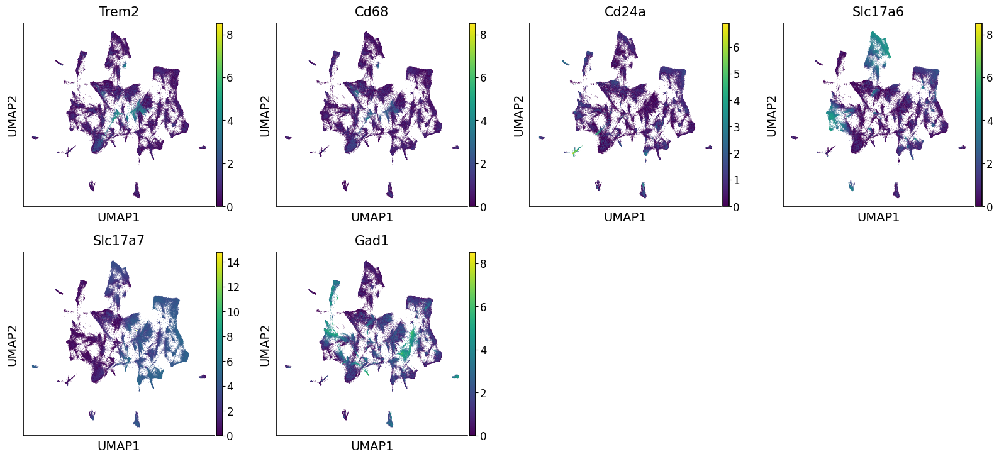

In [ ]:
sc.pl.umap(adata, color=['Trem2', 'Cd68', 'Cd24a', 'Slc17a6', 'Slc17a7', 'Gad1'])

In [ ]:
import sys
sys.path.append('/home/cane/Documents/yoseflab/can/resolVI-eval2/')
import _utils

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cudf/utils/_numba.py:110: UserWarning: Using CUDA toolkit version (12, 5) with CUDA driver version (12, 4) requires minor version compatibility, which is not yet supported for CUDA driver versions 12.0 and above. It is likely that many cuDF operations will not work in this state. Please install CUDA toolkit version (12, 4) to continue using cuDF.
  warnings.warn(
2024-06-01 10:15:24.892551: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


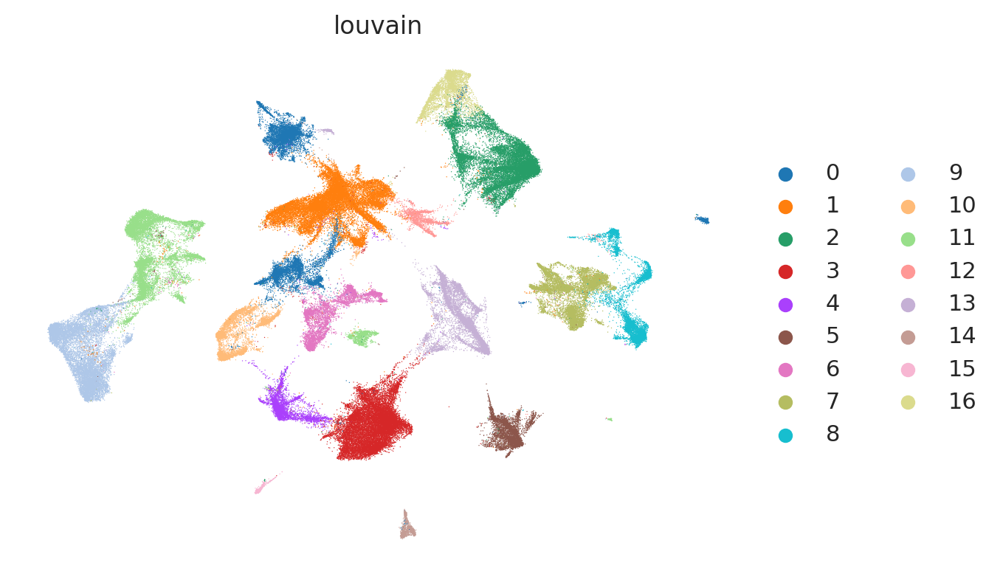

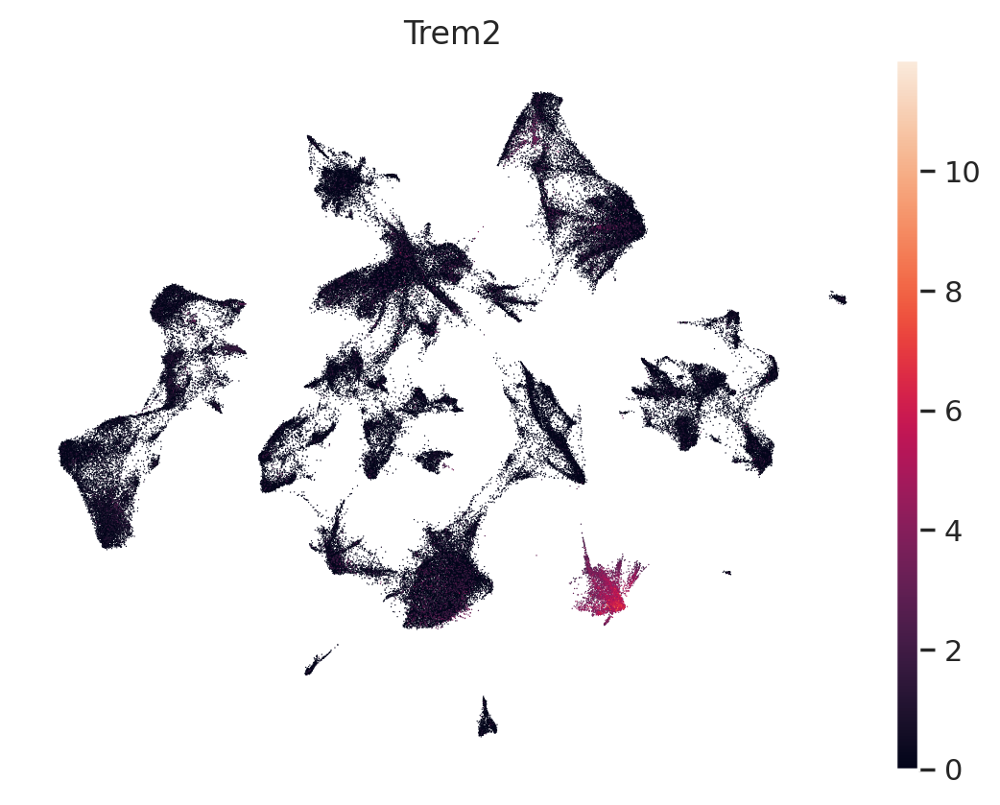

In [ ]:
try:
    _utils.compute_umap_embedding(proseg, representation_key="counts_wo_bg", show=True, key='raw_counts', n_neighbors=10)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


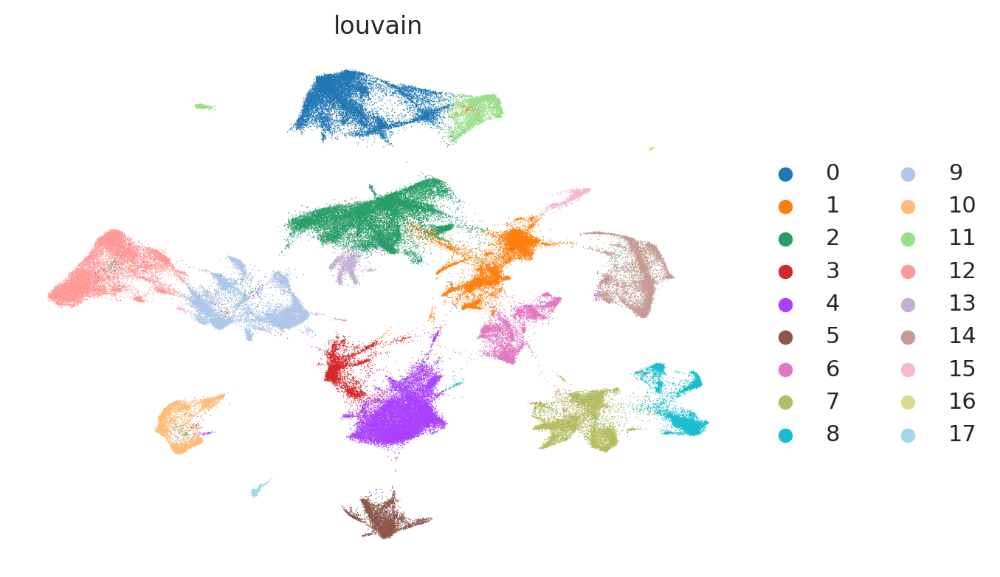

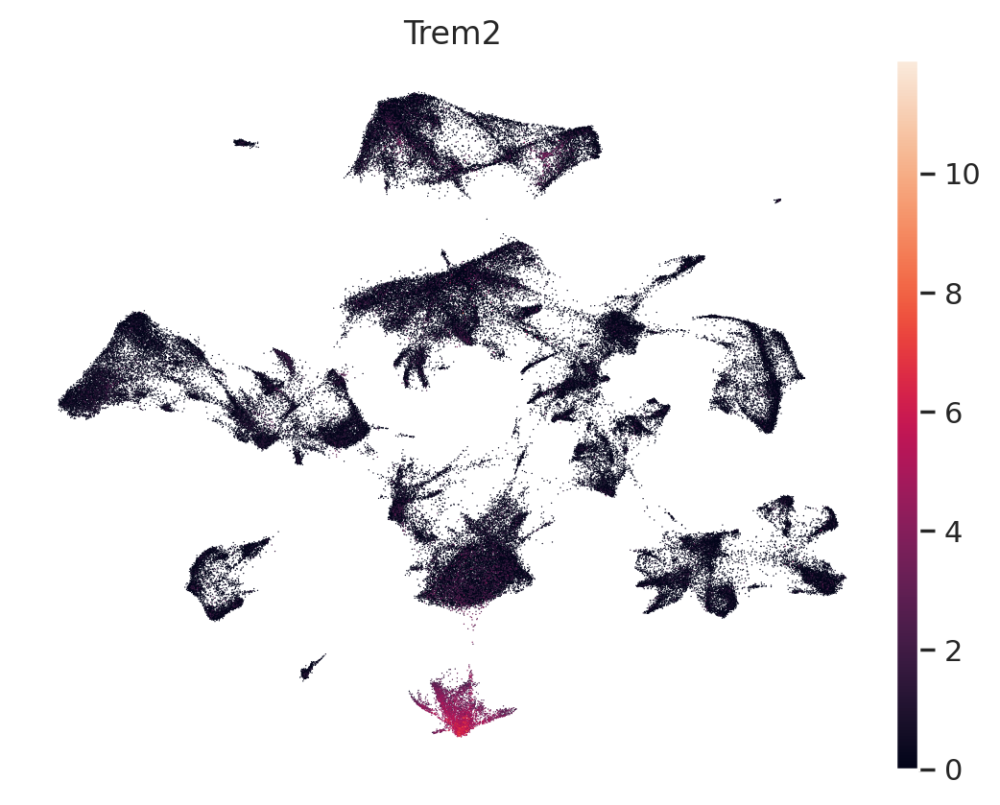

In [ ]:
try:
    _utils.compute_umap_embedding(proseg, representation_key="counts", show=True, key='raw_counts', n_neighbors=10)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


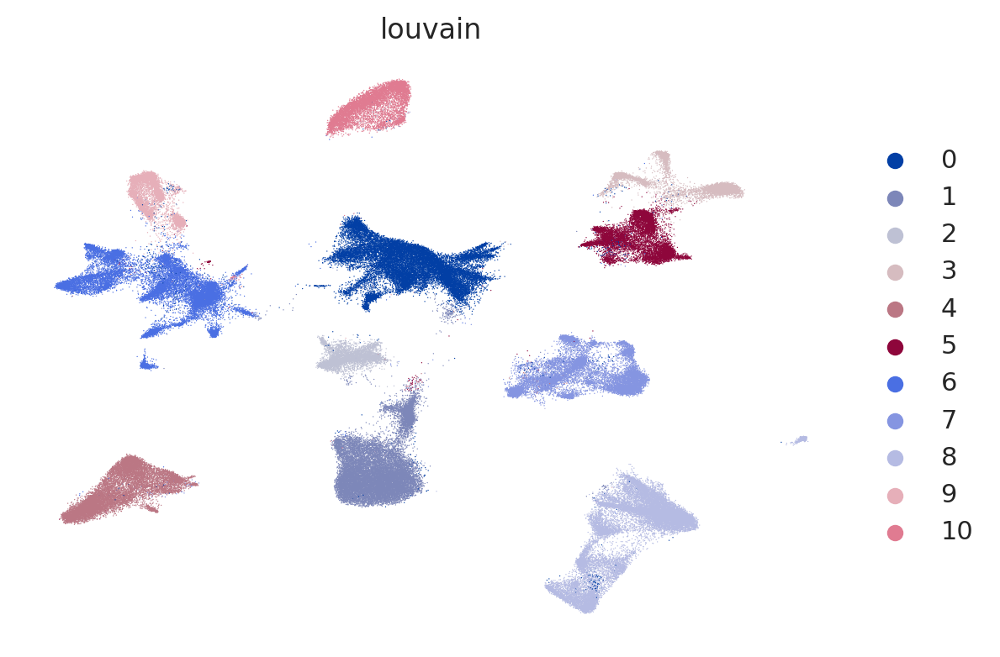

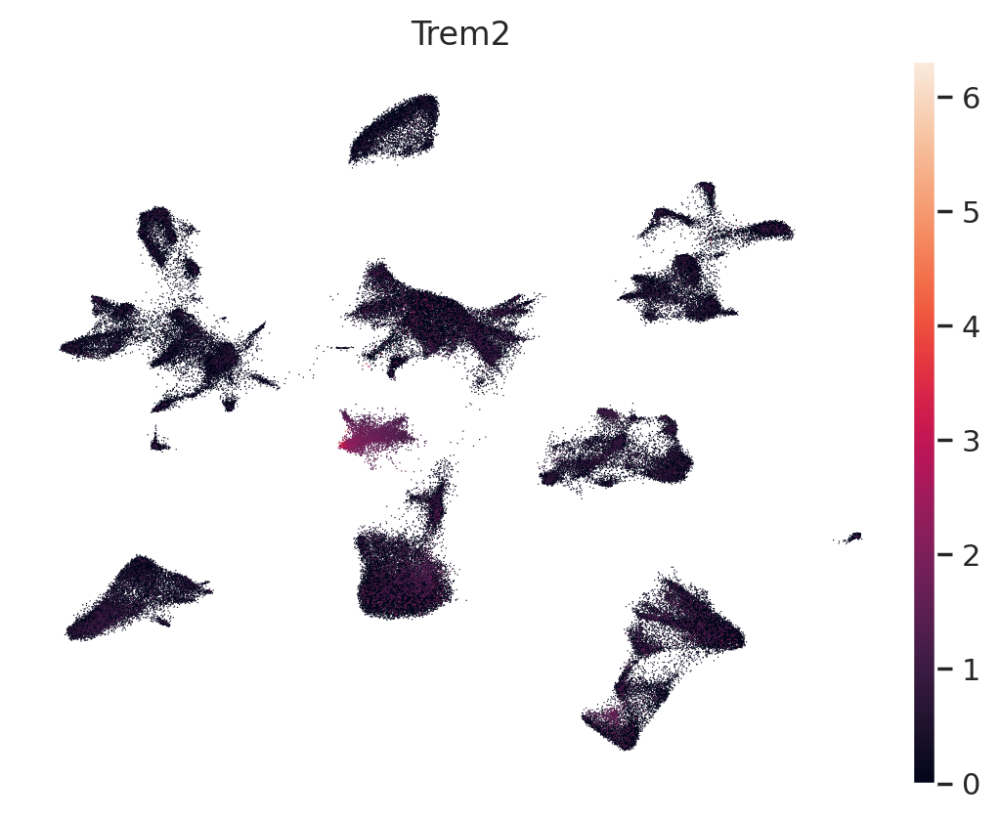

In [ ]:
proseg.layers['estimated'] = proseg.X
try:
    _utils.compute_umap_embedding(proseg, representation_key="estimated", show=True, key='raw_counts', n_neighbors=20)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


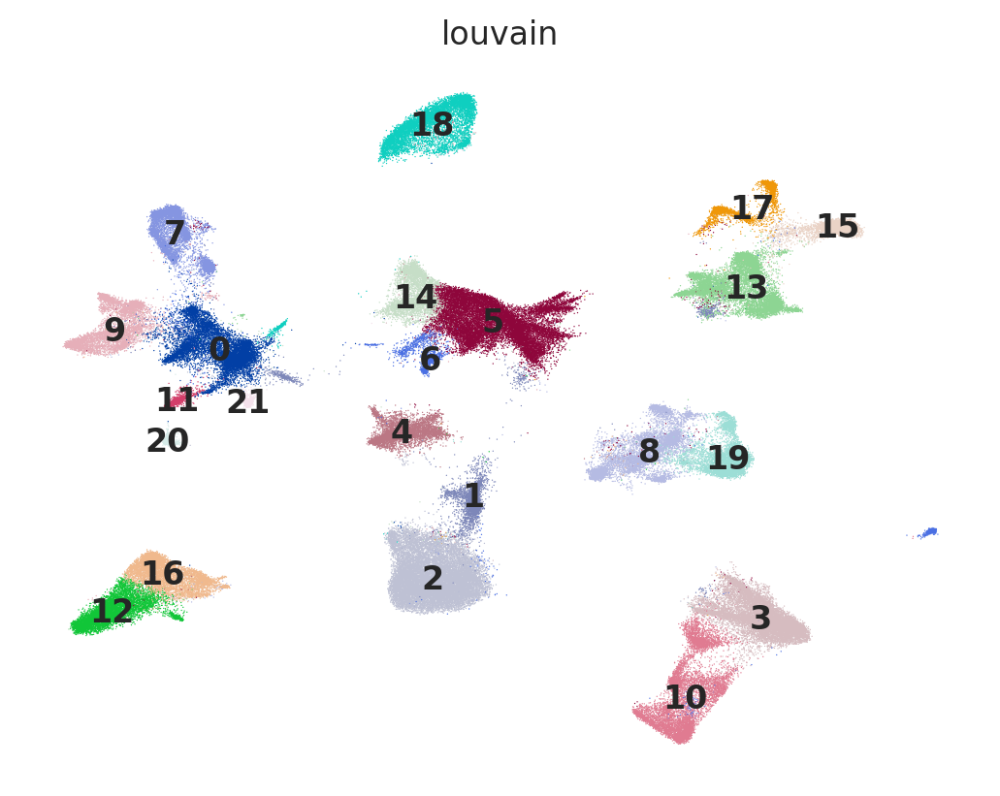

In [ ]:
sc.tl.louvain(proseg, resolution=1.2, flavor='rapids')
sc.pl.umap(proseg, color='louvain', legend_loc='on data')

In [ ]:
del proseg.uns['dendrogram_louvain']

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


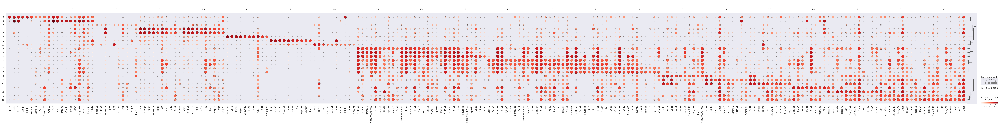

In [ ]:
sc.tl.rank_genes_groups(proseg, groupby='louvain')
sc.pl.rank_genes_groups_dotplot(proseg)

In [ ]:
proseg.obsm['X_spatial'] = proseg.obs[['x', 'y']].values

In [ ]:
cell_type_mapping = {
    '18': 'Excitatory Neurons Thalamus',
    '8': 'Excitatory Neurons L5',
    '0': 'Inhibitory Neurons Hypothalamus',
    '13': 'Excitatory Neurons Amygdala',
    '12': 'Excitatory Neurons L2/3',
    '19': 'Excitatory Neurons L6',
    '14': 'Astrocytes',
    '15': 'Excitatory Neurons Dentate Gyrus',
    '2': 'Oligodendrocyte',
    '21': 'Excitatory Neurons Amygdala medial',
    '16': 'Excitatory Neurons L4',
    '4': 'Microglia',
    '9': 'Inhibitory Neurons Cortical',
    '3': 'Endothelial Cells',
    '1': 'Oligodendrocyte Precursor Cells',
    '17': 'Excitatory Neurons Cornu ammonis',
    '5': 'Astrocytes',
    '10': 'Fibroblast',
    '7': 'Inhibitory Neurons Putamen',
    '6': 'Ependymal Cells',
    '20': 'Inhibitory Neurons Pallidum',
    '11': 'Fibroblast'
}

In [ ]:
proseg.obs['celltypes'] = proseg.obs['louvain'].astype(str).map(cell_type_mapping)

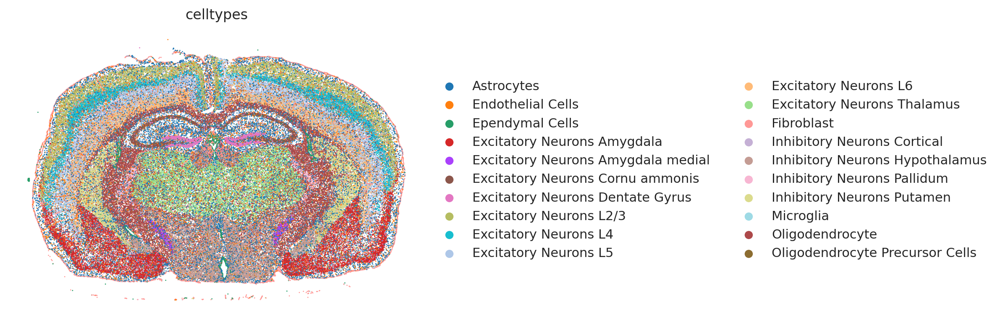

In [ ]:
sc.pl.spatial(proseg, color='celltypes', spot_size=30, sort_order=False)

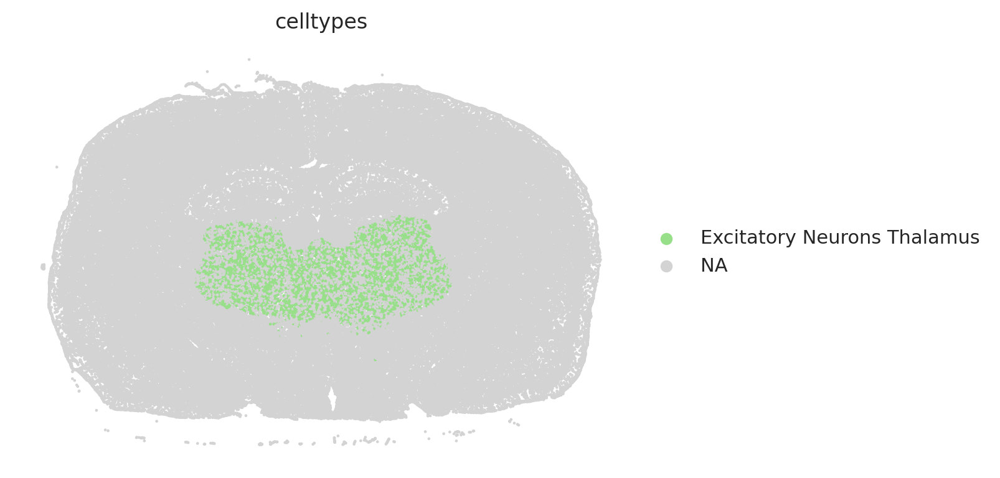

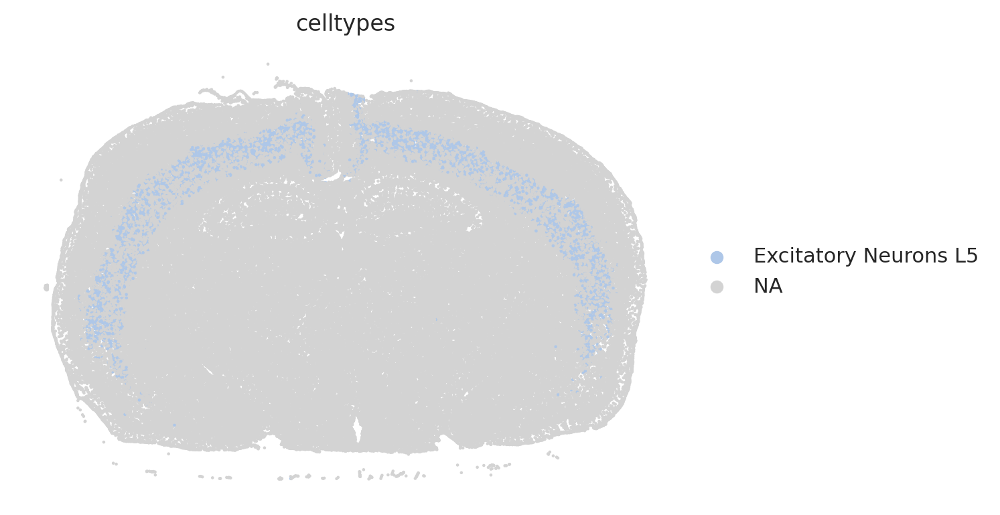

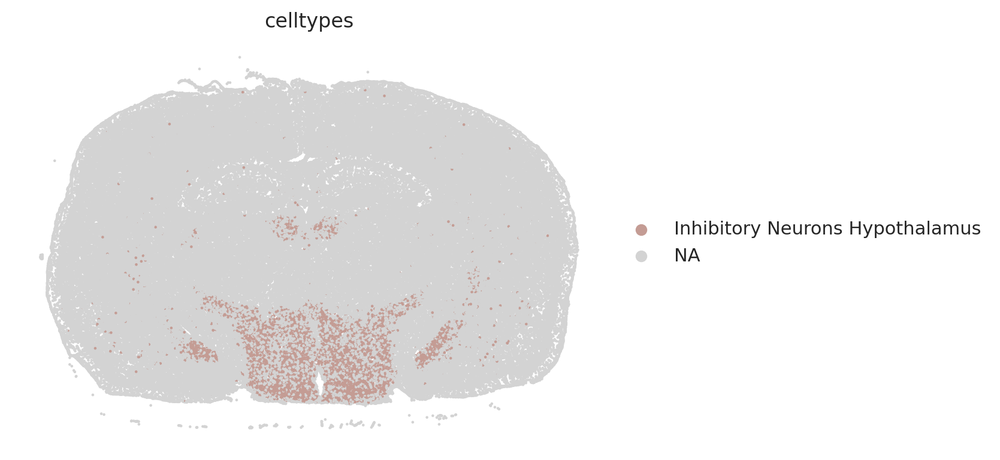

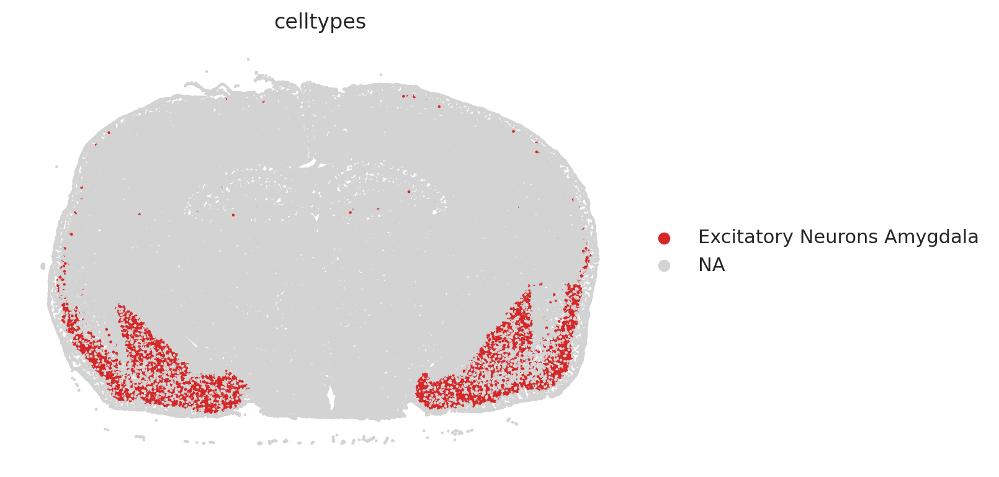

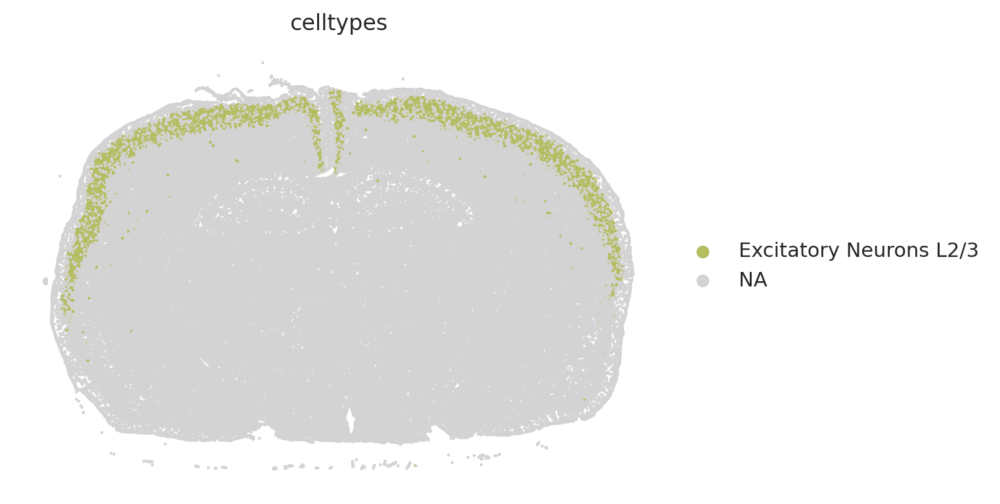

...

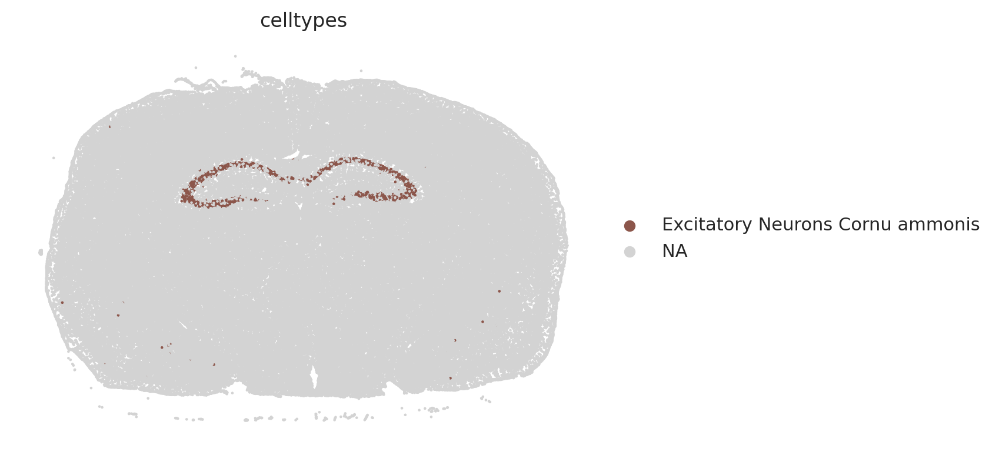

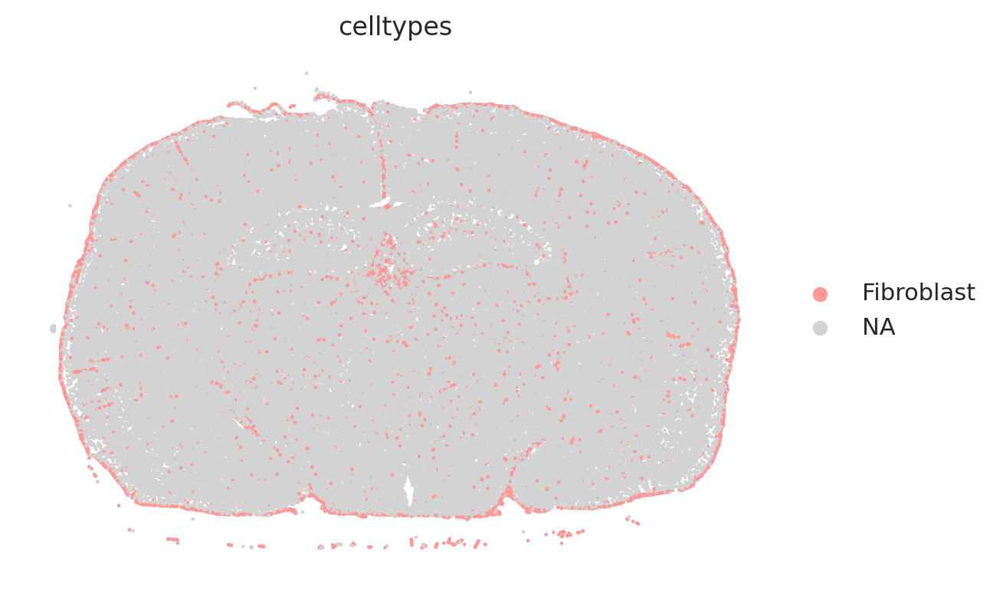

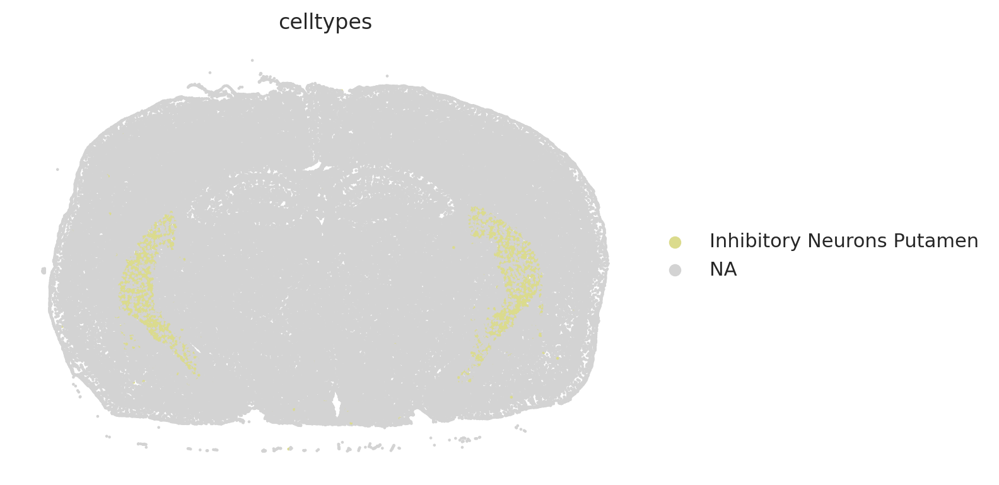

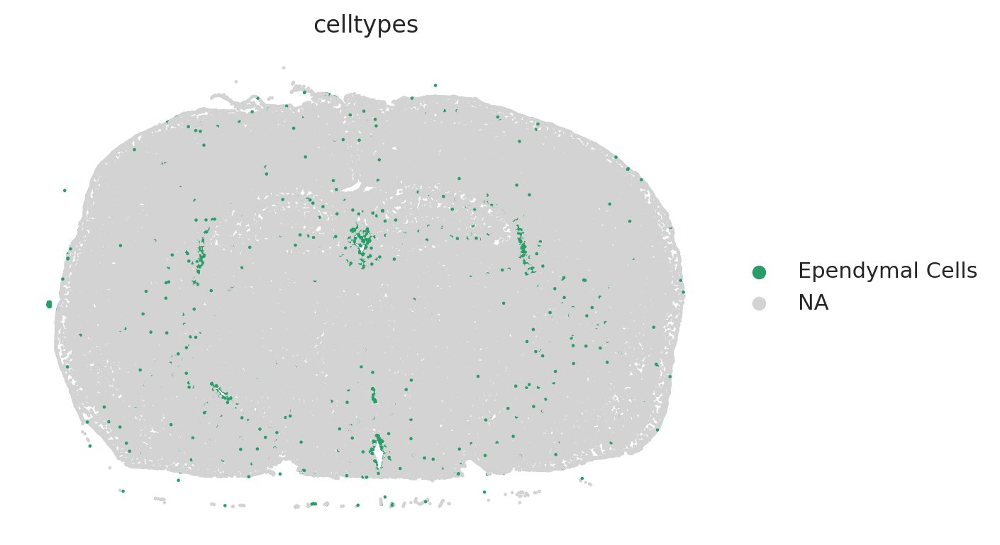

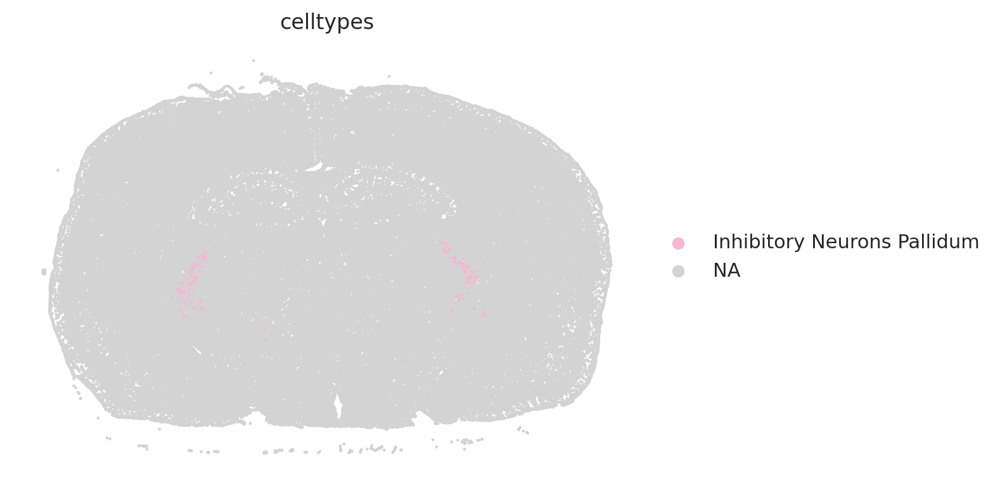

In [ ]:
for i in proseg.obs['celltypes'].unique():
    sc.pl.spatial(proseg, color='celltypes', spot_size=50, sort_order=False, groups=i)

In [ ]:
for i in proseg.obs['louvain'].unique():
    sub = sc.get.rank_genes_groups_df(proseg, i).head(10)
    print('cluster', i, ':        ', ', '.join(sub['names']))

cluster 18 :         Slc17a6, Rims3, Nell1, Prox1, Nrn1, Rnf152, Tmem163, Clmn, Necab2, Inpp4b
cluster 8 :         Slc17a7, Satb2, Neurod6, Hs3st2, Dkk3, Nrn1, Fhod3, Arc, Grik3, Gfra2
cluster 0 :         Vat1l, Tmem255a, Rims3, Cacna2d2, Rasgrf2, Dner, Plcxd3, Cntnap4, Btbd11, Calb2
cluster 13 :         Slc17a7, Cpne6, Bhlhe22, 2010300C02Rik, Nrn1, Bcl11b, Nwd2, Hpcal1, Rasgrf2, Cdh4
cluster 12 :         Lamp5, Satb2, Slc17a7, Nrn1, Igfbp6, Pdzrn3, Tmem132d, Cux2, 2010300C02Rik, Rasgrf2
cluster 19 :         Slc17a7, Grik3, Neurod6, Dkk3, Garnl3, Hs3st2, Nxph3, Fezf2, Igsf21, Bcl11b
cluster 14 :         Ntsr2, Acsbg1, Slc39a12, Aqp4, Rfx4, Id2, Rorb, Mapk4, Rmst, Cdh20
cluster 15 :         2010300C02Rik, Slc17a7, Bhlhe22, Nrn1, Cpne6, Bcl11b, Epha4, Pip5k1b, Sipa1l3, Prdm8
cluster 2 :         Gjc3, Sox10, Zfp536, Opalin, Prox1, Clmn, Dpy19l1, Gng12, Sema6a, Cobll1
cluster 21 :         Slc17a6, Plcxd3, Cacna2d2, Neto2, Nts, Rasgrf2, Plcxd2, Foxp2, Vat1l, Dner
cluster 16 :         Satb2,

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


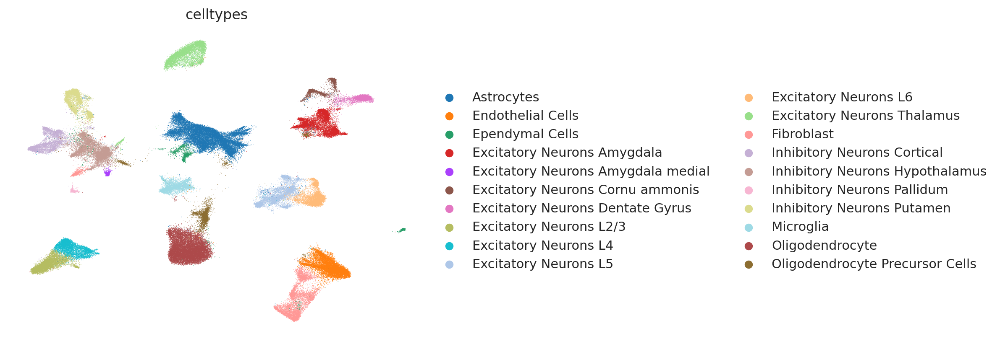

In [ ]:
sc.pl.umap(proseg, color='celltypes')

In [ ]:
proseg_new = sc.read_h5ad('/data/extra_files/xenium/Xenium_V1_FF_Mouse_Brain_Coronal_outs/xenium_brain_proseg.h5ad')

In [ ]:
proseg_new.obsm = proseg.obsm
proseg_new.obs = proseg.obs

In [ ]:
proseg_new.obsm['blank_probes'] = pd.DataFrame(
    proseg_new[:, proseg_new.var_names.str.contains('BLANK')].layers['counts'],
    columns=proseg_new.var_names[proseg_new.var_names.str.contains('BLANK')],
    index=proseg_new.obs_names)
proseg_new.obsm['neg_probe'] = pd.DataFrame(
    proseg_new[:, proseg_new.var_names.str.contains('NegControlProbe')].layers['counts'],
    columns=proseg_new.var_names[proseg_new.var_names.str.contains('NegControlProbe')],
    index=proseg_new.obs_names)
proseg_new.obsm['neg_codeword'] = pd.DataFrame(
    proseg_new[:, proseg_new.var_names.str.contains('NegControlCodeword')].layers['counts'],
    columns=proseg_new.var_names[proseg_new.var_names.str.contains('NegControlCodeword')],
    index=proseg_new.obs_names)

In [ ]:
adata = sc.read_h5ad('xenium_brain/original_newest_bg_high_q05/complete_adata.h5ad')

In [ ]:
proseg_new = proseg_new[:, adata.var_names]

In [ ]:
proseg_new.write_h5ad('/data/extra_files/xenium/Xenium_V1_FF_Mouse_Brain_Coronal_outs/xenium_brain_proseg_processed.h5ad')

### Xenium resegmentation no expansion

In [29]:
pd.read_csv('Xenium_V1_FF_Mouse_Brain_Coronal_wo_expansion/outs/cells.csv.gz')

,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area
0,aaaackhb-1,569.356689,3265.666992,93,0,0,0,0,93,38.789220,38.789220
1,aaaakagf-1,579.518921,3315.016357,164,0,0,0,0,164,62.676877,62.676877
2,aaabmbig-1,575.726562,3319.611084,89,1,0,0,0,90,51.342658,51.342658
3,aaacfelg-1,556.416504,3315.427734,53,0,0,0,0,53,18.243126,18.243126
4,aaacgbdo-1,563.147217,3288.669922,184,0,0,0,0,184,63.805784,63.805784
...,...,...,...,...,...,...,...,...,...,...,...
119878,ojbglkle-1,4007.110107,2239.972412,41,0,0,0,0,41,18.423751,18.423751
119879,ojbgmmfh-1,4017.560303,2238.373291,116,0,0,0,0,116,49.671877,49.671877
119880,ojbgpppj-1,4022.228760,2197.761719,93,0,0,0,0,93,43.846720,43.846720
119881,ojbhklof-1,4012.890869,2212.170410,15,0,0,0,0,15,10.069844,10.069844


In [30]:
adata = sc.read_10x_h5('Xenium_V1_FF_Mouse_Brain_Coronal_wo_expansion/outs/cell_feature_matrix.h5')
obs = pd.read_csv('Xenium_V1_FF_Mouse_Brain_Coronal_wo_expansion/outs/cells.csv.gz', index_col='cell_id')
obs.index = obs.index.astype(str)
adata.obs = obs

In [31]:
adata.var

,gene_ids,feature_types,genome
2010300C02Rik,ENSMUSG00000026090,Gene Expression,Unknown
Acsbg1,ENSMUSG00000032281,Gene Expression,Unknown
Acta2,ENSMUSG00000035783,Gene Expression,Unknown
Acvrl1,ENSMUSG00000000530,Gene Expression,Unknown
Adamts2,ENSMUSG00000036545,Gene Expression,Unknown
...,...,...,...
Vwc2l,ENSMUSG00000045648,Gene Expression,Unknown
Wfs1,ENSMUSG00000039474,Gene Expression,Unknown
Zfp366,ENSMUSG00000050919,Gene Expression,Unknown
Zfp536,ENSMUSG00000043456,Gene Expression,Unknown


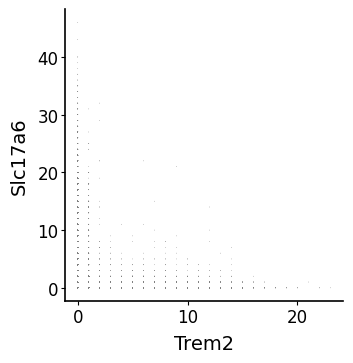

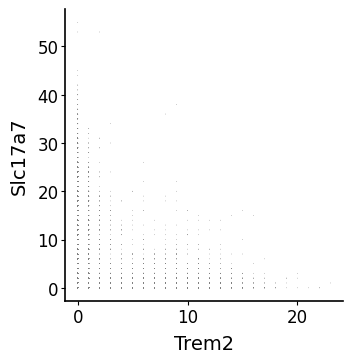

In [32]:
sc.pl.scatter(adata, x='Trem2', y='Slc17a6')
sc.pl.scatter(adata, x='Trem2', y='Slc17a7')

In [33]:
adata.layers['raw_counts'] = adata.X.copy()


In [42]:
adata.obsm['X_spatial'] = adata.obs[['x_centroid', 'y_centroid']].values

In [43]:
adata.write_h5ad('xenium_brain_nuclei.h5ad')

### Proseg no expansion

In [4]:
proseg = ad.AnnData(X=pd.read_csv('Xenium_V1_FF_Mouse_Brain_Coronal_wo_expansion/outs/expected-counts.csv.gz'))

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [5]:
cell_meta = pd.read_csv('Xenium_V1_FF_Mouse_Brain_Coronal_wo_expansion/outs/transcript-metadata.csv.gz')
cell_meta = cell_meta # [cell_meta['background']==0]
cell_avg = cell_meta.groupby('assignment').mean()
cell_avg = cell_avg.loc[proseg.obs.index.astype(int).intersection(cell_avg.index)]
cell_avg.index = [str(i) for i in cell_avg.index]
proseg = proseg[cell_avg.index]
proseg.obs = cell_avg

/tmp/ipykernel_1252933/2167069701.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  cell_avg = cell_meta.groupby('assignment').mean()


In [6]:
cell_meta['v'] = np.ones(cell_meta.shape[0], int)
counts = cell_meta[['assignment', 'gene', 'v']].groupby(['assignment', 'gene']).sum().pivot_table('v', index='assignment', columns='gene').fillna(0)
proseg.layers['counts'] = counts.loc[proseg.obs_names.astype(int), proseg.var_names]

In [7]:
counts_sub = cell_meta.loc[cell_meta['background']==0, ['assignment', 'gene', 'v']].groupby(['assignment', 'gene']).sum().pivot_table('v', index='assignment', columns='gene').fillna(0)
counts_sub_all = 0 * counts
counts_sub_all.loc[counts_sub.index] = counts_sub
proseg.layers['counts_wo_bg'] = counts_sub_all.loc[proseg.obs_names.astype(int), proseg.var_names]

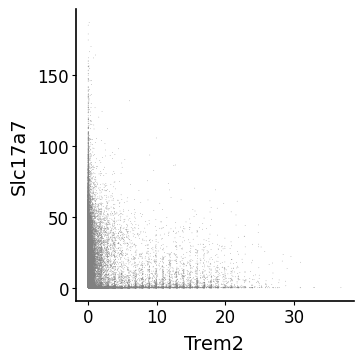

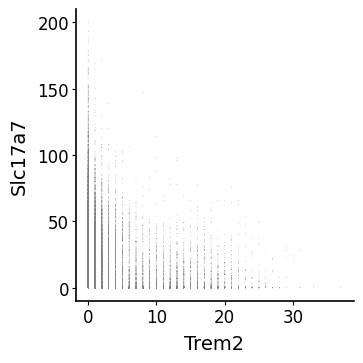

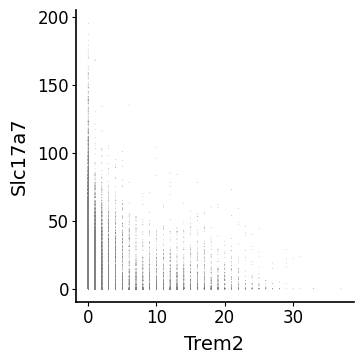

In [8]:
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7')
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7', layers='counts')
sc.pl.scatter(proseg, x='Trem2', y='Slc17a7', layers='counts_wo_bg')

In [9]:
import sys
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils

In [10]:
proseg.layers['estimated'] = proseg.X.copy()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/cudf/utils/_numba.py:110: UserWarning: Using CUDA toolkit version (12, 5) with CUDA driver version (12, 4) requires minor version compatibility, which is not yet supported for CUDA driver versions 12.0 and above. It is likely that many cuDF operations will not work in this state. Please install CUDA toolkit version (12, 4) to continue using cuDF.
  warnings.warn(


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


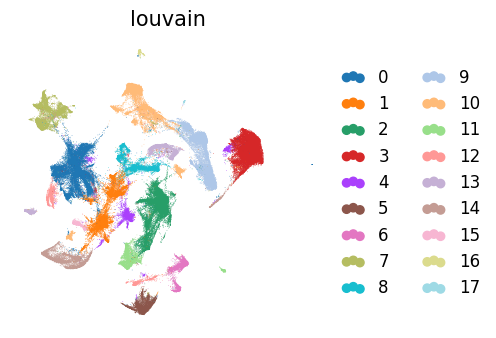

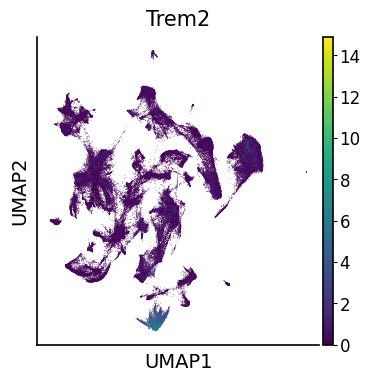

In [11]:
try:
    _utils.compute_umap_embedding(proseg, representation_key="counts_wo_bg", show=True, key='raw_counts', n_neighbors=10)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


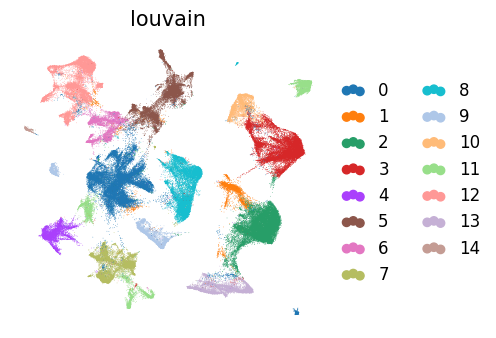

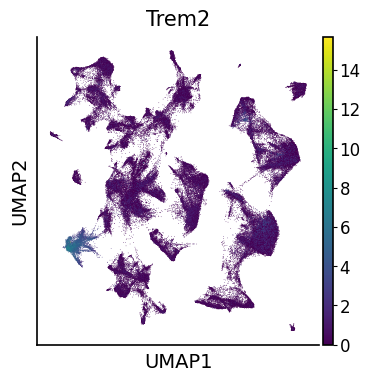

In [12]:
try:
    _utils.compute_umap_embedding(proseg, representation_key="counts", show=True, key='raw_counts', n_neighbors=10)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


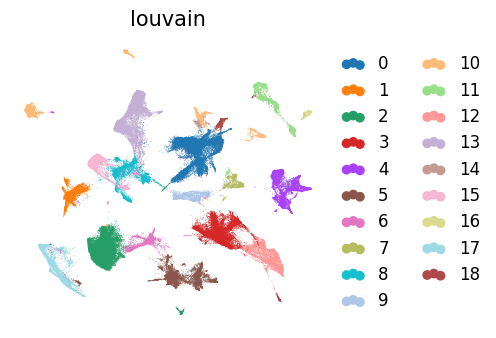

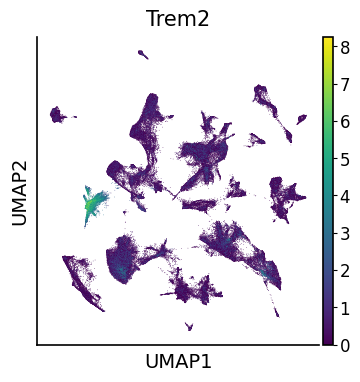

In [13]:
try:
    _utils.compute_umap_embedding(proseg, representation_key="estimated", show=True, key='raw_counts', n_neighbors=20)
except:
    sc.pl.umap(proseg, color='Trem2')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


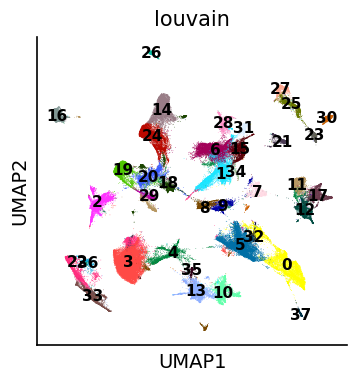

In [14]:
sc.tl.louvain(proseg, resolution=1.2, flavor='rapids')
sc.pl.umap(proseg, color='louvain', legend_loc='on data')

In [15]:
proseg.obsm['X_spatial'] = proseg.obs[['x', 'y']].values

In [18]:
from scipy.sparse import csr_matrix as csr

In [19]:
for i in proseg.layers:
    proseg.layers[i] = csr(proseg.layers[i])

In [20]:
proseg.write_h5ad('xenium_brain_proseg_nucleus.h5ad')

## Downstream

### Proseg again

In [21]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
resolvi_semisupervised = RESOLVI.load(model_path)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 0 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:13,  3.59it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:14,  3.37it/s, v_num=1]


In [22]:
proseg = sc.read_h5ad('xenium_brain_proseg_processed.h5ad')

In [23]:
proseg.obs['cluster'] = 'unassigned'

In [24]:
from scipy.sparse import csr_matrix as csr
for i in proseg.layers:
    proseg.layers[i] = csr(proseg.layers[i])
proseg.layers['raw_counts'] = proseg.layers['counts'].copy()

In [25]:
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


In [26]:
proseg.obs['fov'] = 3.
#proseg.obs['fov'] = proseg.obs['fov'].astype('category')
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    resolvi_semisupervised,
)

/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:18,  2.69it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:18,  2.66it/s, v_num=1]


In [27]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [20:26<00:00, 408.80s/it]


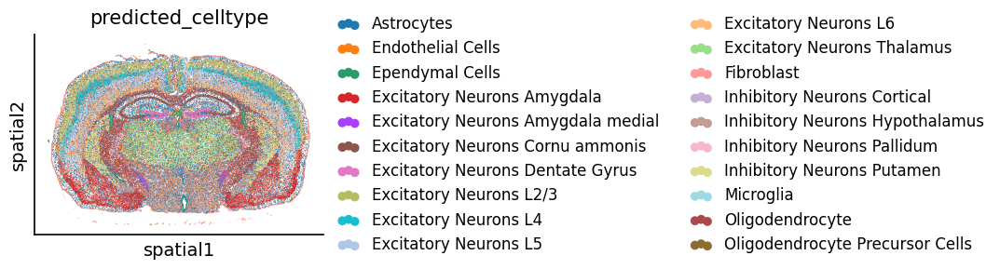

In [28]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [29]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


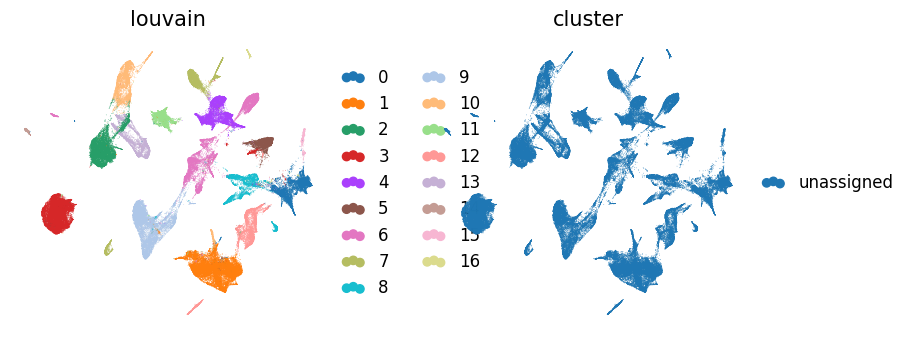

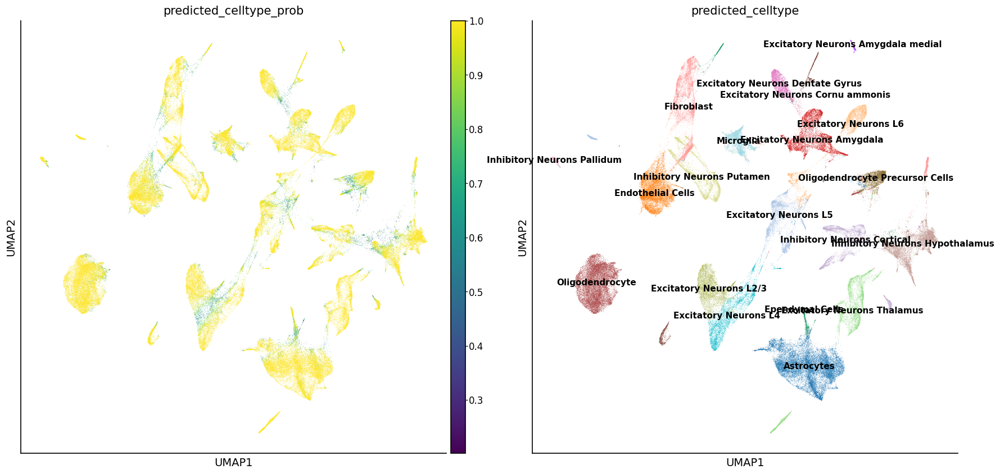

In [30]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [31]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/5 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 5/5 [20:22<00:00, 244.52s/it]


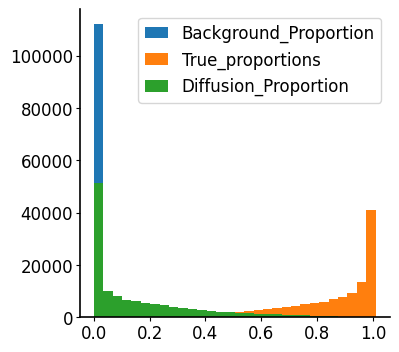

In [32]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'resegmented_nucleus_histogram_proportions.pdf')
plt.show()

In [33]:
proseg.write_h5ad('xenium_brain_proseg_processed.h5ad')

### Baysor

In [34]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
resolvi_semisupervised = RESOLVI.load(model_path)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 0 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:11,  4.11it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:12,  4.04it/s, v_num=1]


In [35]:
proseg = sc.read_h5ad('xenium_brain_baysor.h5ad')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [36]:
from scipy.sparse import csr_matrix as csr

proseg.obs['fov'] = 3.0
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg.X = csr(proseg.X)
proseg.layers['raw_counts'] = proseg.X.copy()
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()
proseg.obs.rename(columns={'cluster': 'baysor_cluster'}, inplace=True)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [37]:
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
proseg.obs_names = [f'{j}__{i}' for i, j in zip(proseg.obs_names, proseg.obs['fov_original'])]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    model_path,
)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_manager.py:212: UserWarning: Missing labels key cluster. Filling in with unlabeled category unassigned.
  field_registry[_constants._STATE_REGISTRY_KEY] = field.transfer_field(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:17,  2.83it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:17,  2.75it/s, v_num=1]


In [39]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [16:05<00:00, 321.98s/it]


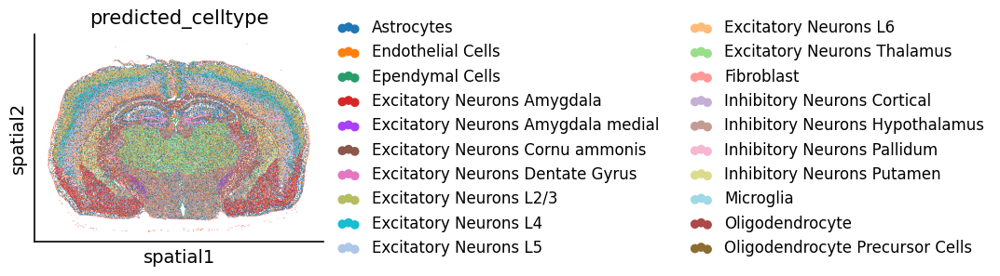

In [40]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [41]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


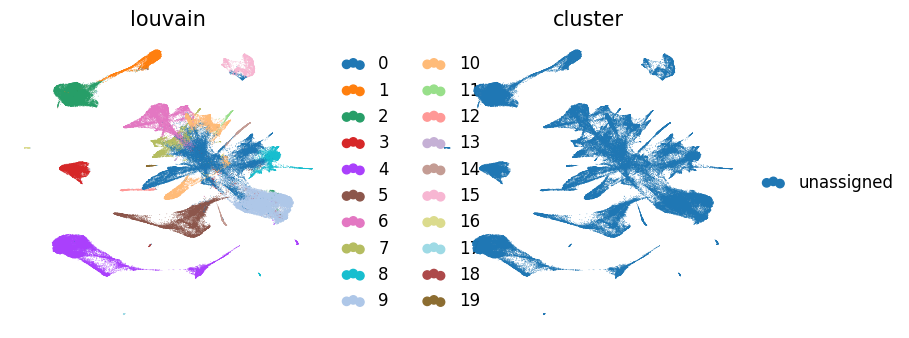

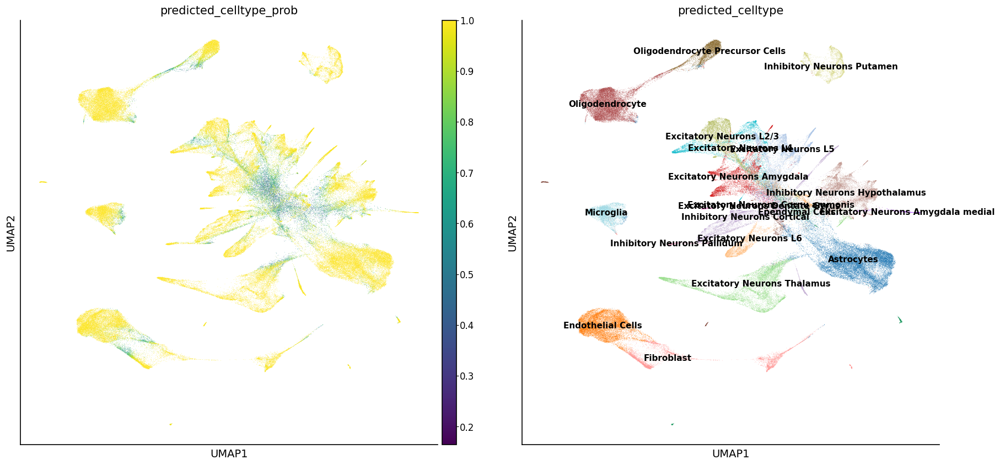

In [42]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

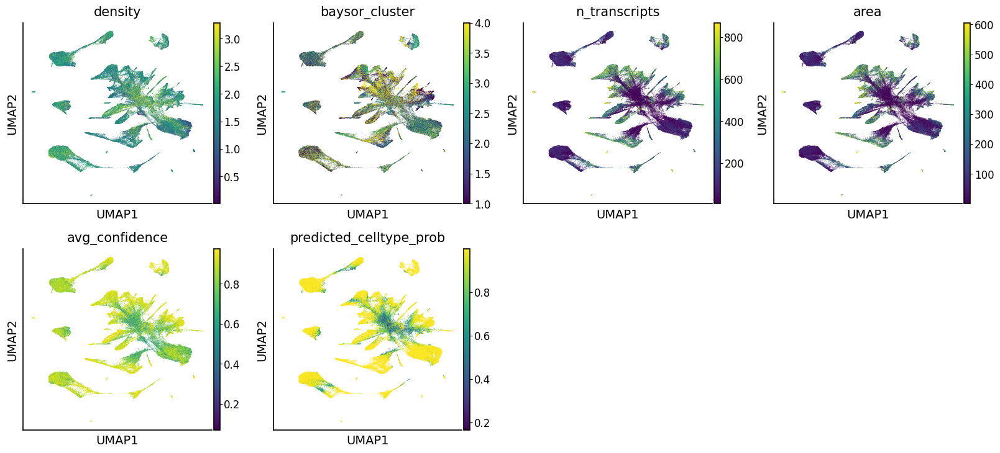

In [43]:
sc.pl.umap(proseg, color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence', 'predicted_celltype_prob'], legend_loc='on data', sort_order=False, vmax='p95')

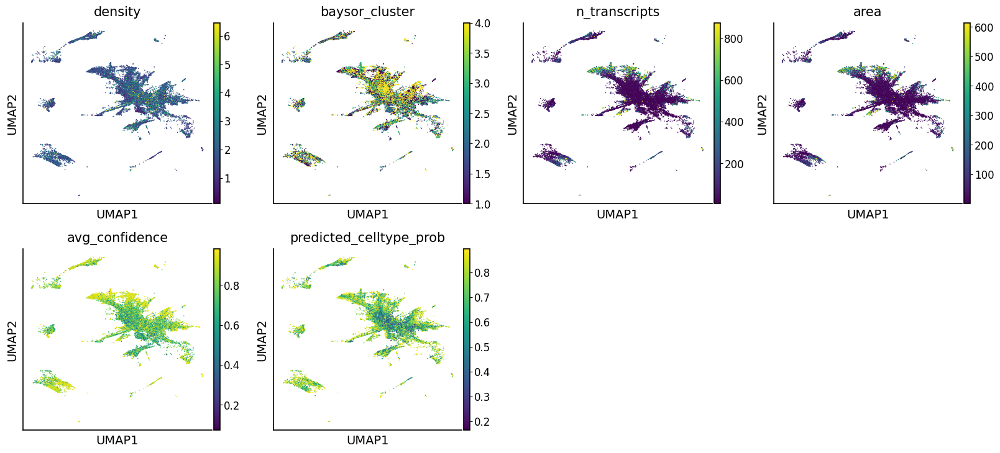

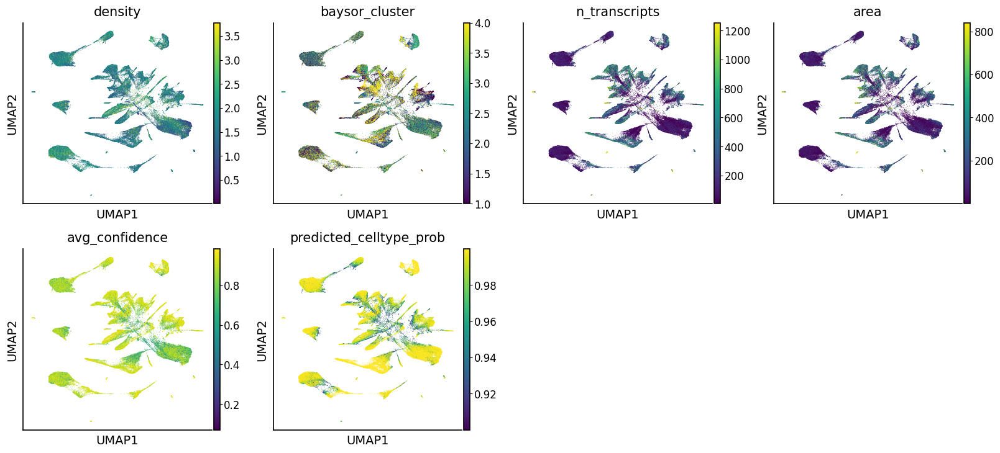

In [44]:
sc.pl.umap(
    proseg[proseg.obs['predicted_celltype_prob']<0.9], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence', 'predicted_celltype_prob'],
    legend_loc='on data', sort_order=False, vmax='p98')
sc.pl.umap(
    proseg[proseg.obs['predicted_celltype_prob']>0.9], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence', 'predicted_celltype_prob'],
    legend_loc='on data', sort_order=False, vmax='p98')

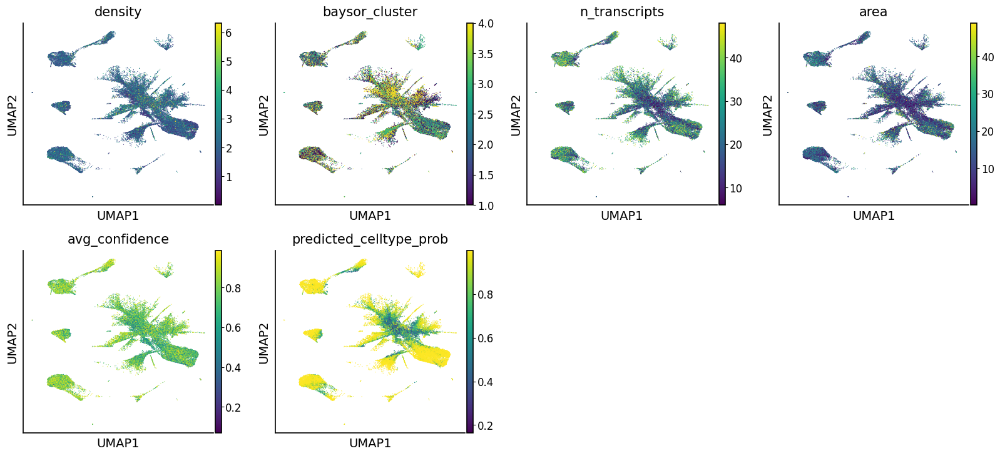

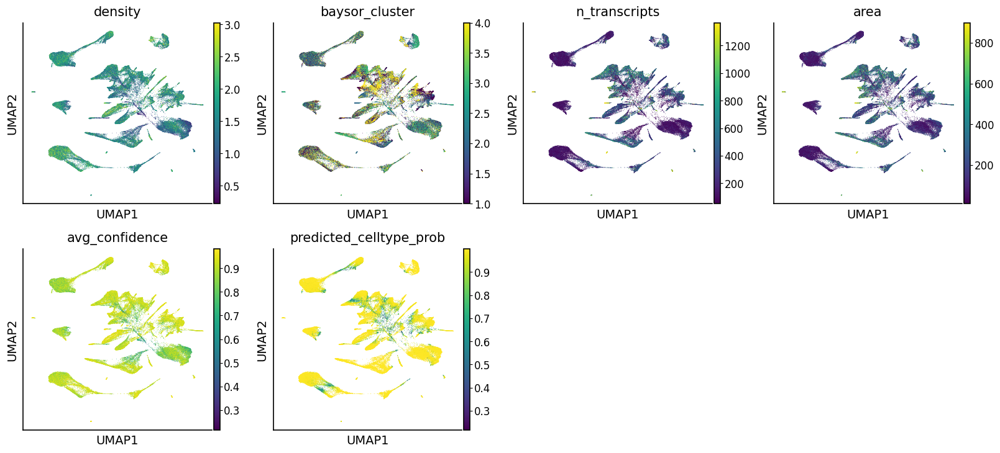

In [45]:
sc.pl.umap(
    proseg[proseg.obs['n_transcripts']<50], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence', 'predicted_celltype_prob'],
    legend_loc='on data', sort_order=False, vmax='p98')
sc.pl.umap(
    proseg[proseg.obs['n_transcripts']>50], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence', 'predicted_celltype_prob'],
    legend_loc='on data', sort_order=False, vmax='p98')

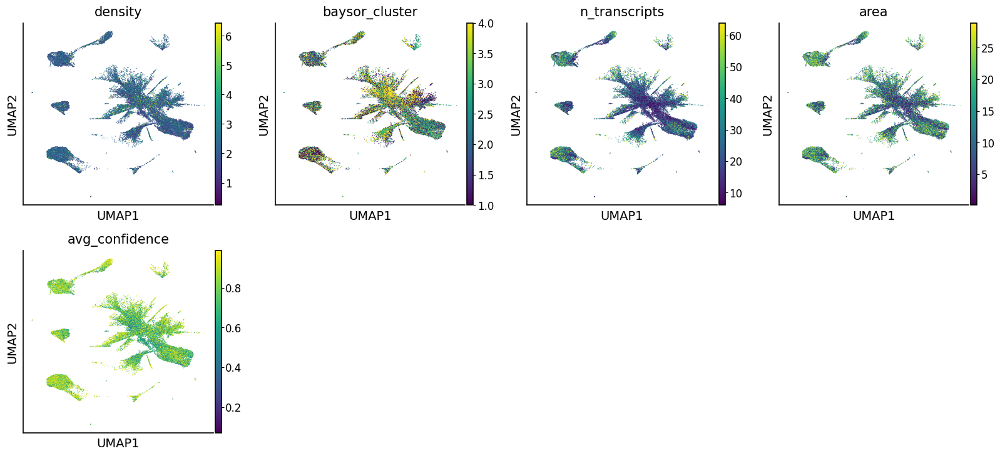

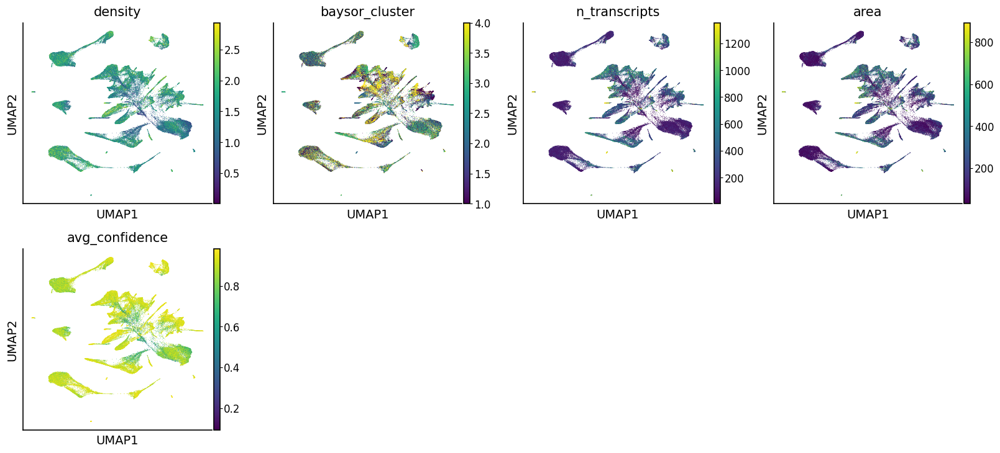

In [46]:
sc.pl.umap(proseg[proseg.obs['area']<30], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence'], legend_loc='on data', sort_order=False, vmax='p98')
sc.pl.umap(proseg[proseg.obs['area']>30], color=['density', 'baysor_cluster', 'n_transcripts', 'area', 'avg_confidence'], legend_loc='on data', sort_order=False, vmax='p98')

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


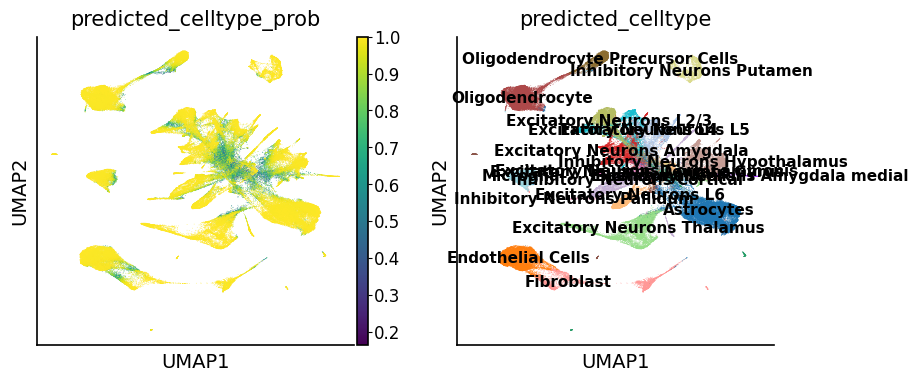

In [47]:
sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [48]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/5 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 5/5 [14:22<00:00, 172.51s/it]


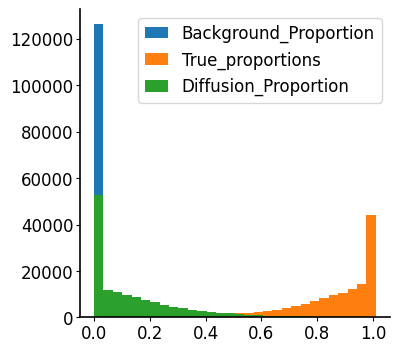

In [49]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'baysor_histogram_proportions.pdf')
plt.show()

Sampling macro-batches, batch:   0%|          | 0/5 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 5/5 [14:20<00:00, 172.18s/it]


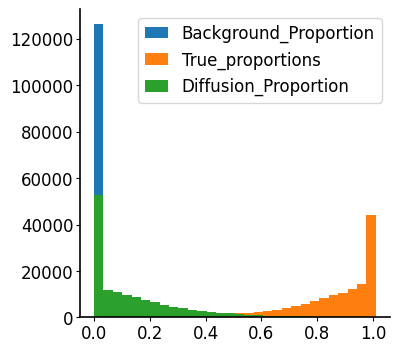

In [50]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'baysor_histogram_proportions.pdf')
plt.show()

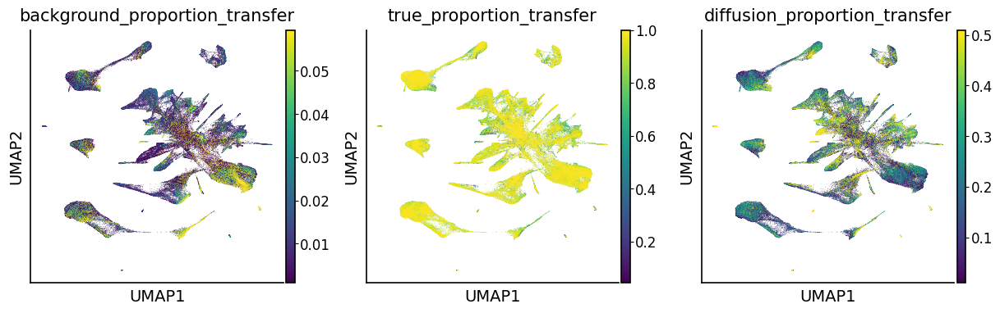

In [51]:
sc.pl.umap(proseg, color=['background_proportion_transfer', 'true_proportion_transfer','diffusion_proportion_transfer'], legend_loc='on data', vmax='p95')

In [52]:
proseg.write_h5ad('xenium_brain_baysor_processed.h5ad')

### Xenium original

In [53]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
resolvi_semisupervised = RESOLVI.load(model_path)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 0 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:08,  5.79it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:08,  5.64it/s, v_num=1]


In [54]:
proseg = sc.read_h5ad('xenium_brain_original.h5ad')

In [55]:
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


In [56]:
proseg.obs['fov'] = 3.0
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    model_path,
)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_manager.py:212: UserWarning: Missing labels key cluster. Filling in with unlabeled category unassigned.
  field_registry[_constants._STATE_REGISTRY_KEY] = field.transfer_field(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:12,  3.93it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:12,  3.86it/s, v_num=1]


In [57]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [13:19<00:00, 266.62s/it]


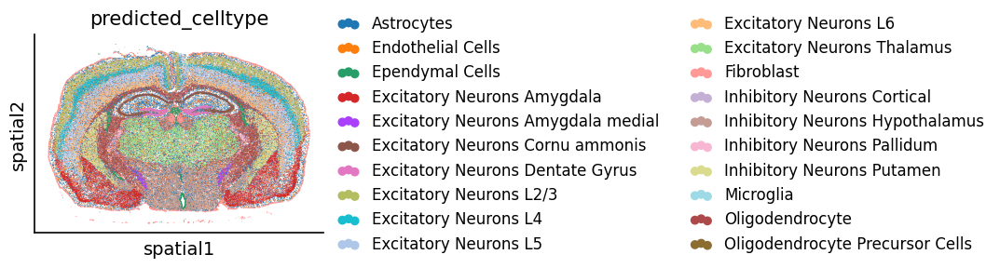

In [58]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [59]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


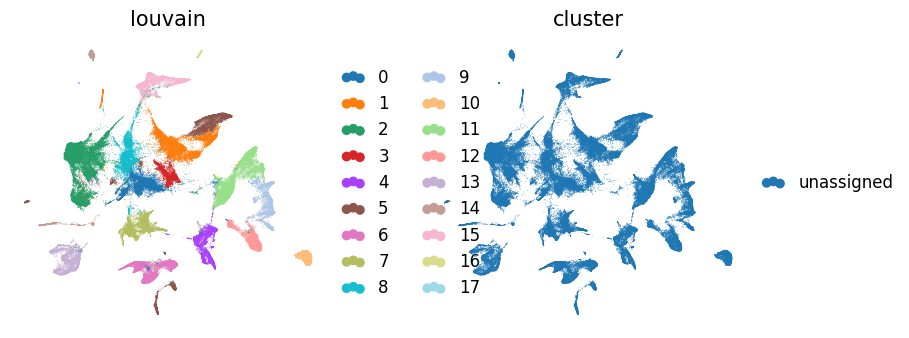

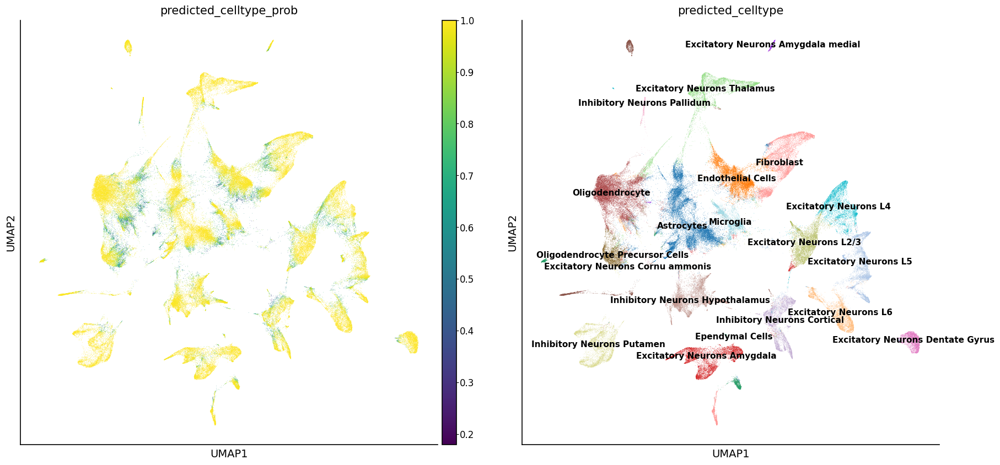

In [60]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [61]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/5 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 5/5 [13:17<00:00, 159.58s/it]


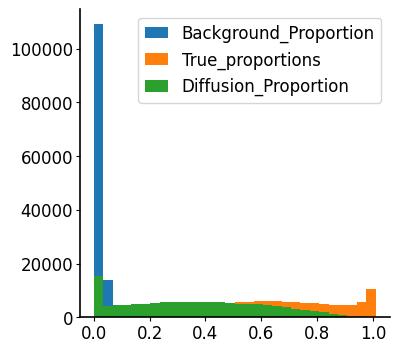

In [62]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'resegmented_original_histogram_proportions.pdf')
plt.show()

In [63]:
proseg.write_h5ad('xenium_brain_original_processed.h5ad')

### Xenium resegmentation no expansion

In [64]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
resolvi_semisupervised = RESOLVI.load(model_path)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 0 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  5.22it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  5.09it/s, v_num=1]


In [65]:
proseg = sc.read_h5ad('xenium_brain_nuclei.h5ad')

In [66]:
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


In [67]:
proseg.obs['fov'] = 3.0
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    model_path,
)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_manager.py:212: UserWarning: Missing labels key cluster. Filling in with unlabeled category unassigned.
  field_registry[_constants._STATE_REGISTRY_KEY] = field.transfer_field(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:12,  3.89it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:12,  3.80it/s, v_num=1]


In [68]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [12:09<00:00, 243.29s/it]


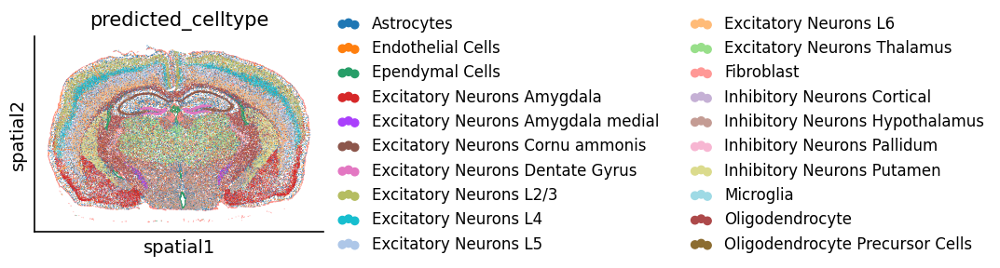

In [69]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [70]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


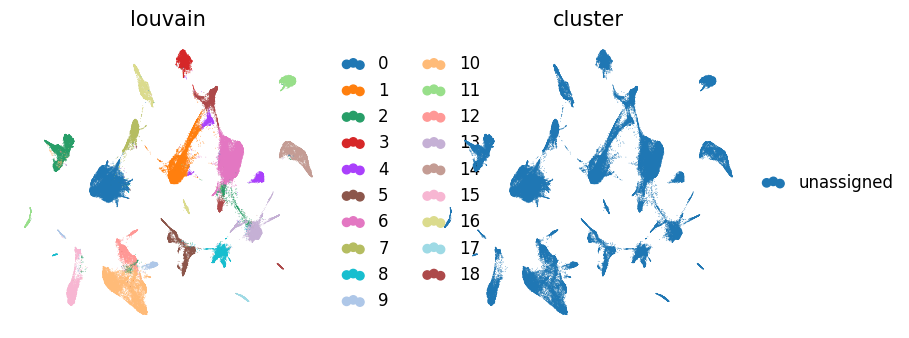

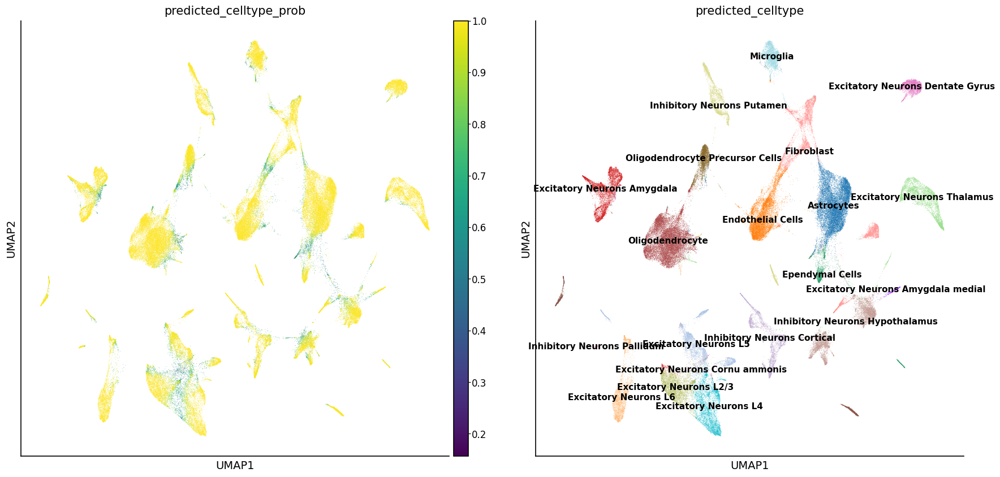

In [71]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [72]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/4 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 4/4 [12:04<00:00, 181.04s/it]


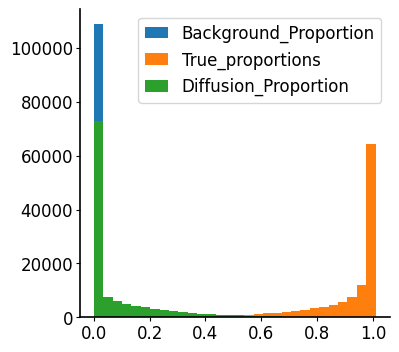

In [73]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'resegmented_nucleus_histogram_proportions.pdf')
plt.show()

In [74]:
proseg.write_h5ad('xenium_brain_resegmented_nucleus_processed.h5ad')

### Xenium resegmentation no expansion

In [75]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
resolvi_semisupervised = RESOLVI.load(model_path)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 0 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  4.99it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:10,  4.81it/s, v_num=1]


In [76]:
proseg = sc.read_h5ad('xenium_brain_nuclei.h5ad')

In [77]:
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


In [78]:
proseg.obs['fov'] = 3.0
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    model_path,
)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_manager.py:212: UserWarning: Missing labels key cluster. Filling in with unlabeled category unassigned.
  field_registry[_constants._STATE_REGISTRY_KEY] = field.transfer_field(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  5.34it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  5.21it/s, v_num=1]


In [79]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [12:10<00:00, 243.37s/it]


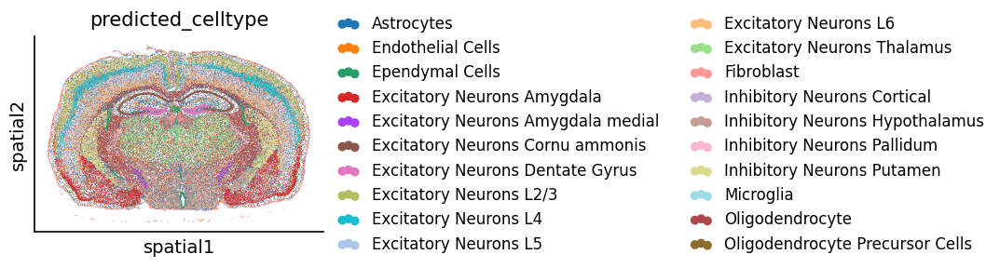

In [80]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [81]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


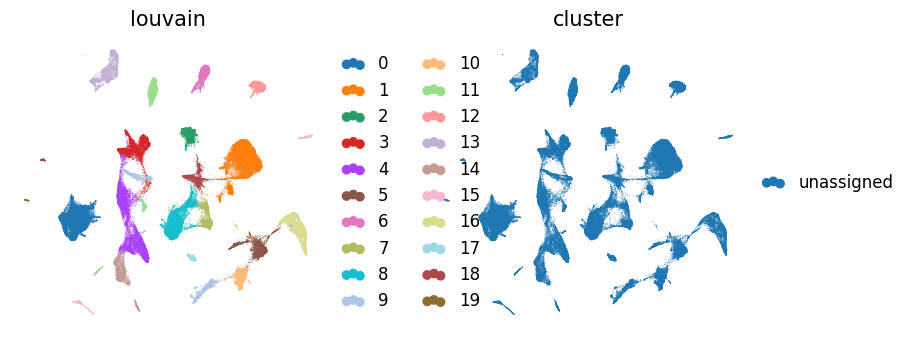

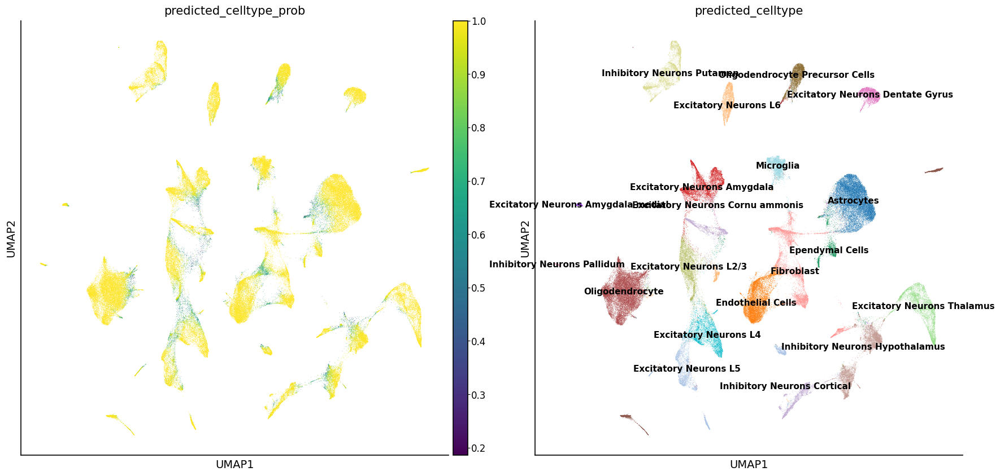

In [82]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [83]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/4 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 4/4 [12:07<00:00, 181.79s/it]


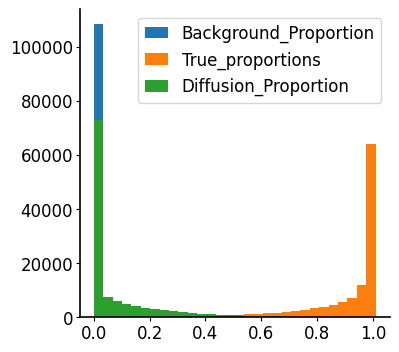

In [84]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'resegmented_nucleus_histogram_proportions.pdf')
plt.show()

In [85]:
proseg.write_h5ad('xenium_brain_resegmented_nucleus_processed.h5ad')

### ProSeg no expansion

In [86]:
model_path = '/home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervised/resolvae'
#resolvi_semisupervised = RESOLVI.load(model_path)

In [87]:
proseg = sc.read_h5ad('xenium_brain_proseg_nucleus.h5ad')

In [88]:
RESOLVI.prepare_query_anndata(proseg, model_path)
proseg.layers['raw_counts'] = proseg.layers['counts']
proseg = proseg[proseg.layers['raw_counts'].sum(1)>5].copy()

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    
INFO     Found 100.0% reference vars in query data.                                                                


In [89]:
proseg.obs['fov'] = 3.0
proseg.obs_names = ['query_' + i for i in proseg.obs_names]
resolvi_transfer = RESOLVI.load_query_data(
    proseg,
    model_path,
)

INFO     File                                                                                                      
         /home/cane/Documents/yoseflab/can/resolvi_eval_final2/xenium_brain/proseg_newest_bg_high_q05_semisupervise
         d/resolvae/model.pt already downloaded                                                                    


/home/cane/Documents/yoseflab/can/resolVI/scvi/data/fields/_dataframe_field.py:226: UserWarning: Category 130253 in adata.obs['_scvi_ind_x'] has fewer than 3 cells. Models may not train properly.
  new_mapping = _make_column_categorical(
/home/cane/Documents/yoseflab/can/resolVI/scvi/data/_manager.py:212: UserWarning: Missing labels key cluster. Filling in with unlabeled category unassigned.
  field_registry[_constants._STATE_REGISTRY_KEY] = field.transfer_field(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/lightning/pytorch/trainer/configuration_validator.py:69: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:09,  5.01it/s, v_num=1]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/50:   2%|▏         | 1/50 [00:00<00:10,  4.88it/s, v_num=1]


In [90]:
proseg.obsm['celltype_transfer'] = resolvi_transfer.predict(soft=True, num_samples=10, batch_size=10000)
proseg.obs['predicted_celltype'] = proseg.obsm['celltype_transfer'].idxmax(axis=1)
proseg.obs['predicted_celltype_prob'] = proseg.obsm['celltype_transfer'].max(axis=1)

Sampling macro-batches, batch:   0%|          | 0/3 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 3/3 [12:47<00:00, 255.99s/it]


/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


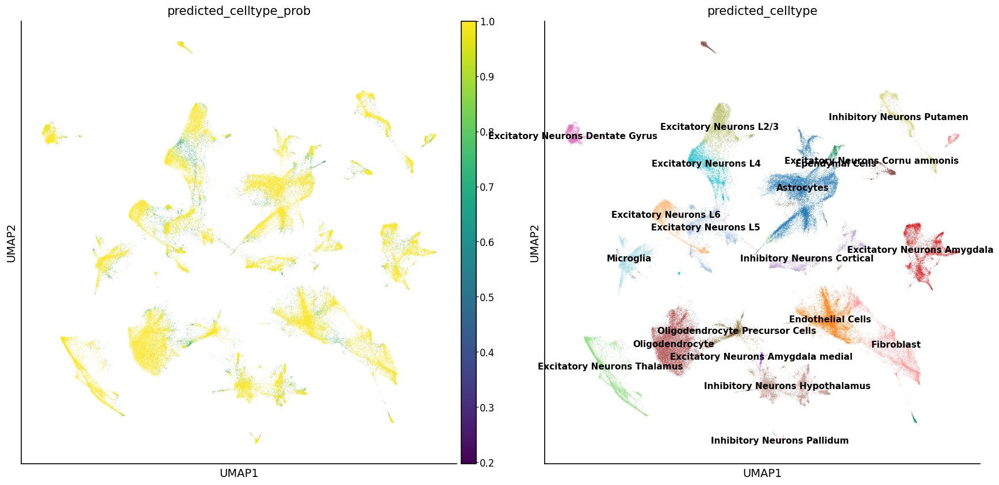

In [91]:
with plt.rc_context({'figure.figsize': (10, 10)}):
    sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

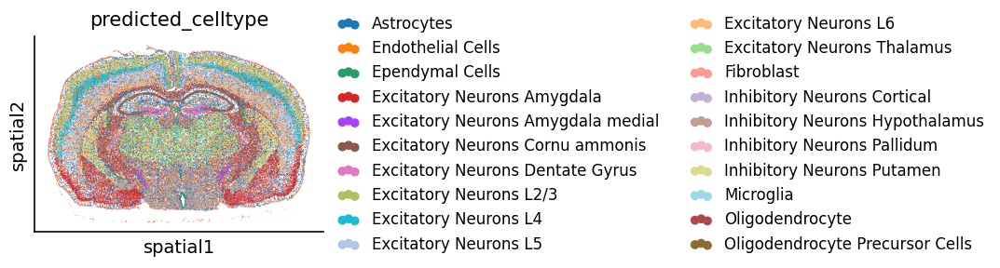

In [92]:
sc.pl.spatial(proseg, color='predicted_celltype', spot_size=30, sort_order=False)

In [93]:
proseg.obsm['X_resolvi'] = resolvi_transfer.get_latent_representation()

/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/cane/miniconda3/envs/resolvi_new/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


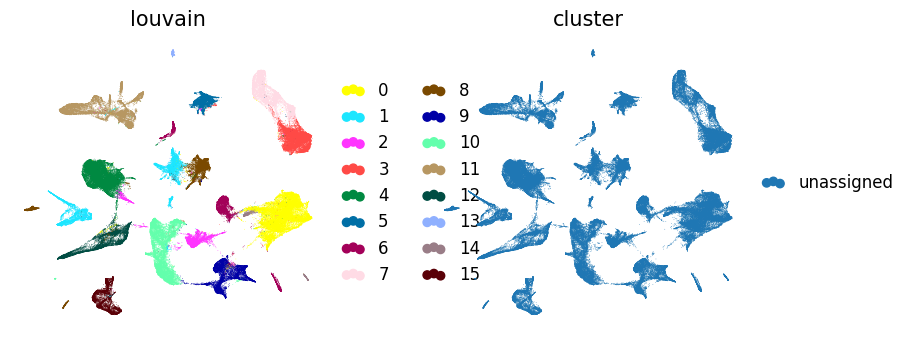

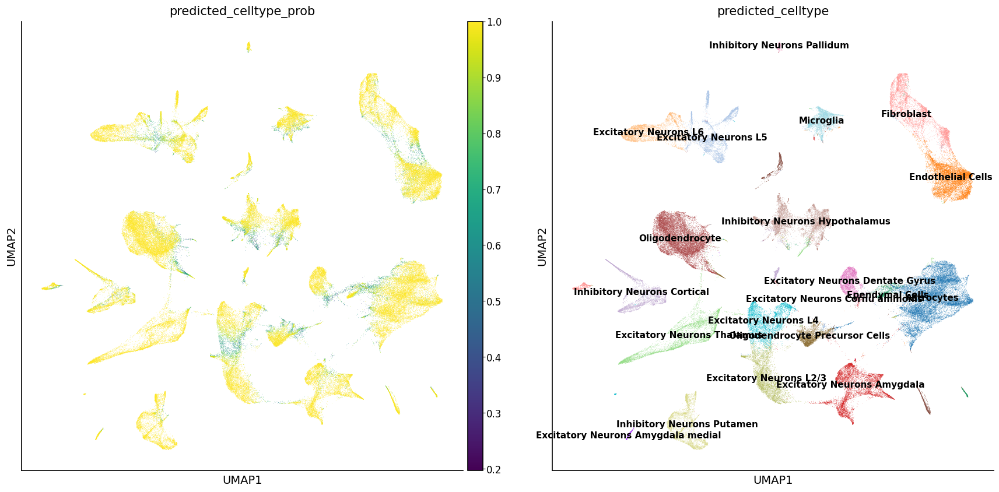

In [94]:
sys.path.append('/home/cane/Documents/yoseflab/can/resolvi_eval_final2')
import _utils
try:
    _utils.compute_umap_embedding(proseg, representation_key="X_resolvi", n_comps=None, show=True, n_neighbors=20, min_dist_umap=0.2, extra_save='transferred_latent')
except:
    with plt.rc_context({'figure.figsize': (10, 10)}):
        sc.pl.umap(proseg, color=['predicted_celltype_prob', 'predicted_celltype'], legend_loc='on data')

In [95]:
proseg.obsm['X_umap_transferred'] = proseg.obsm['X_umap']
proseg.obsm['X_resolvi_transferred'] = proseg.obsm['X_resolvi']

Sampling macro-batches, batch:   0%|          | 0/5 [00:00<?, ?it/s]

Sampling macro-batches, batch: 100%|██████████| 5/5 [12:49<00:00, 153.95s/it]


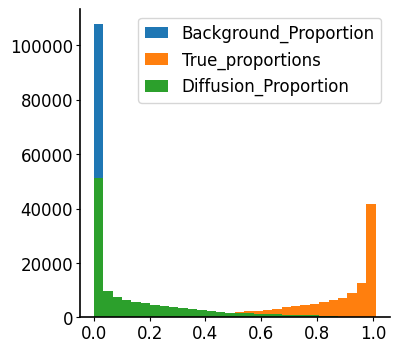

In [96]:
samples = resolvi_transfer.sample_posterior_predictive(
    model=resolvi_transfer.module.model_residuals,
    return_sites=['mixture_proportions'],
    num_samples=10, return_samples=False, batch_size=5000, macro_batch_size=30000)
samples = pd.DataFrame(samples).T

proseg.obs['true_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 0]
proseg.obs['diffusion_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 1]
proseg.obs['background_proportion_transfer'] = samples.loc['post_sample_means', 'mixture_proportions'][:, 2]

_ = plt.hist(proseg.obs['background_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['true_proportion_transfer'], bins=30, range=(0,1.01))
_ = plt.hist(proseg.obs['diffusion_proportion_transfer'], bins=30, range=(0,1.01))
plt.legend(['Background_Proportion', 'True_proportions', 'Diffusion_Proportion'])
plt.savefig(f'proseg_nucleus_histogram_proportions.pdf')
plt.show()

In [97]:
proseg.write_h5ad('xenium_brain_proseg_nucleus_processed.h5ad')